# Bookmarks

In [1]:
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import os
import sys
import re
import pandas as pd 
import glob
import scipy
import scipy.io
from collections import Counter
import scanpy as sc
import gseapy as gp
import h5py
import louvain
import harmonypy as hm
import scrublet as scr
from matplotlib import rcParams
#from GSVA import gsva, gmt_to_dataframe
rcParams['figure.figsize'] = 12,12
file_figs = ''
from methods import *
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)
sc.settings.figdir = '../figures/fig2/'

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.7.2
sinfo       0.3.4
-----
PIL                 8.1.2
anyio               NA
appdirs             1.4.4
argon2              20.1.0
attr                21.2.0
babel               2.9.1
backcall            0.2.0
bioservices         1.6.0
brotli              NA
bs4                 4.9.3
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
colorama            0.4.4
colorlog            NA
cycler              0.10.0
cython_runtime      NA
dateutil  

In [2]:
adata = sc.read_h5ad("../h5ad/celltypes_60_6000_500_0.1.h5ad")

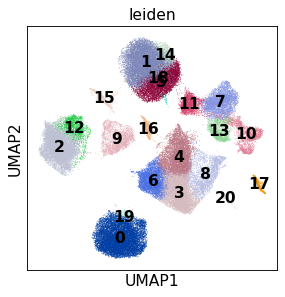

In [23]:
%matplotlib inline
from matplotlib import rcParams
rcParams['figure.figsize'] = 12,12
file_figs = ''
from methods import *
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)
sc.settings.figdir = '../figures/fig1/'

#sc.tl.rank_genes_groups(adata, 'leiden', method='t-test', n_genes = 1000)
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.umap(adata, color = 'leiden', legend_loc = 'on data')

categories: AD, CM, EEC, etc.
var_group_labels: MESO


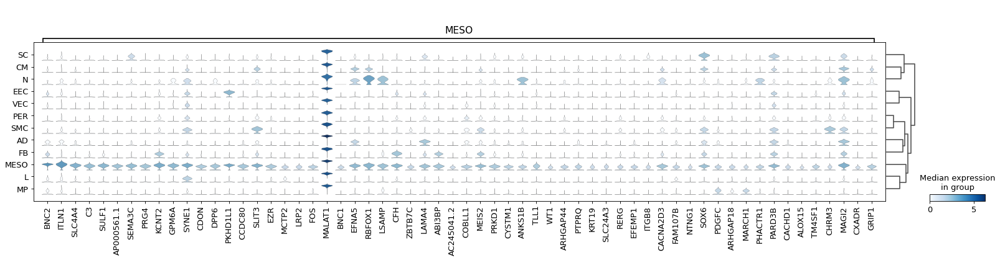

categories: AD, CM, EEC, etc.
var_group_labels: VEC


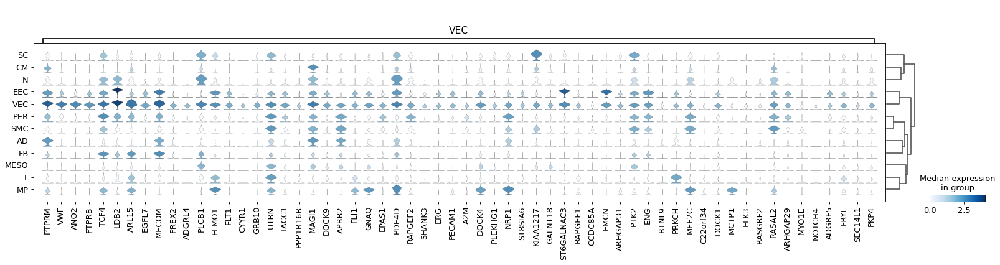

categories: AD, CM, EEC, etc.
var_group_labels: EEC


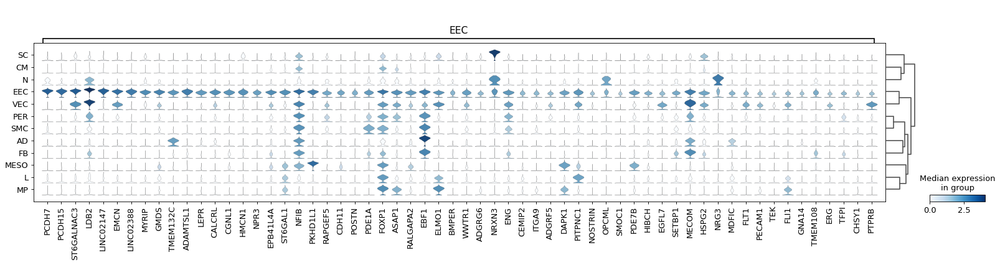

categories: AD, CM, EEC, etc.
var_group_labels: PER


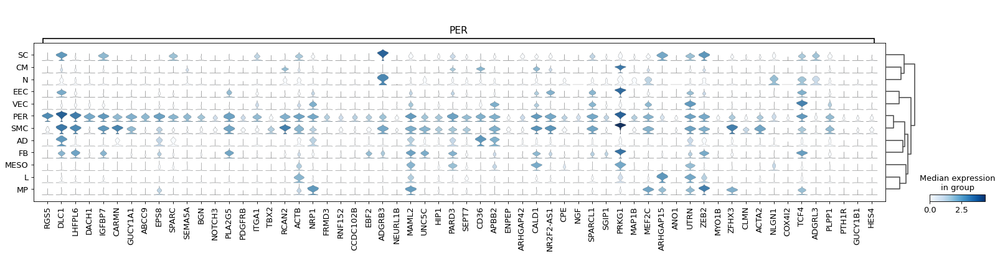

In [28]:
sc.pl.rank_genes_groups_stacked_violin(adata, groupby = "cell_types", n_genes = 60, groups = ["MESO"], dendrogram = True)
sc.pl.rank_genes_groups_stacked_violin(adata, groupby = "cell_types", n_genes = 60, groups = ["VEC"], dendrogram = True)
sc.pl.rank_genes_groups_stacked_violin(adata, groupby = "cell_types", n_genes = 60, groups = ["EEC"], dendrogram = True)
sc.pl.rank_genes_groups_stacked_violin(adata, groupby = "cell_types", n_genes = 60, groups = ["PER"], dendrogram = True)

In [ ]:
adata.obs.cell_types.value_counts()

In [66]:
def percentage(adata):
    distrib = adata.obs.cell_types.value_counts()
    num_cells = adata.obs.shape[0]
    cell_types = ['CM', 'EEC', 'FB', 'MESO', 'VEC', 'MP', 'PER', 'L', 'SC', 'AD', 'SMC', 'N']
    perc = []
    for cell_type  in cell_types:
        if cell_type in list(set(adata.obs.cell_types)):
            perc.append(round((100 * distrib[cell_type] / num_cells), 2))
        else:
            perc.append(0)
    return(perc)

In [67]:
percentages = {}
for phenotype in set(adata.obs.phenotype):
    percentages[phenotype] = percentage(adata[adata.obs.phenotype == phenotype])

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [68]:
cell_types = ['CM', 'EEC', 'FB', 'MESO', 'VEC', 'MP', 'PER', 'L', 'SC', 'AD', 'SMC', 'N']
df = pd.DataFrame(percentages, index = cell_types)

In [69]:
df

,Control,CAD,HF_CAD,HF_Congestive
CM,21.80,37.81,23.66,29.84
EEC,26.48,18.86,31.62,11.29
FB,19.44,16.25,10.06,15.54
MESO,16.82,9.46,14.36,15.04
VEC,7.79,6.70,12.21,21.51
MP,3.12,3.37,2.72,2.71
PER,1.61,2.80,1.60,1.64
L,0.84,1.14,1.39,0.98
SC,1.08,1.11,0.94,0.77
AD,0.23,1.58,0.64,0.24


In [70]:
df.index = ["Cardiomyocytes", "Endocardial EC", "Fibroblasts", "Mesothelial", "Vascular EC", "Macrophages", "Pericytes", "Lymphocytes", "Schwann cells", "Adipocytes", 
            "Smooth muscle", "Neurons"]

In [71]:
df.columns = ["Heart failure (Ischemic)", "Heart failure (no Ischemic)", "Control", "Ischemic"]

In [72]:
import matplotlib
myorder=[0,1,2,3,4,5,6,7,8,9,10,11]
myorder=[1,2,3,5,11,6,8,4,10,9,0,7]
colors_raw = list(rcParams["axes.prop_cycle"][0:13])
colors_raw = [colors_raw[i] for i in myorder]
colors_raw = list(colors_raw)
colors = []
for elt in colors_raw:
    colors.append(matplotlib.colors.to_rgba(elt['color']))

In [73]:
colors

[(1.0, 0.4980392156862745, 0.054901960784313725, 1.0),
 (0.15294117647058825, 0.6196078431372549, 0.40784313725490196, 1.0),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 1.0),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354, 1.0),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353, 1.0),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902, 1.0),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529, 1.0),
 (0.6666666666666666, 0.25098039215686274, 0.9882352941176471, 1.0),
 (1.0, 0.7333333333333333, 0.47058823529411764, 1.0),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274, 1.0),
 (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 1.0),
 (0.7098039215686275, 0.7411764705882353, 0.3803921568627451, 1.0)]

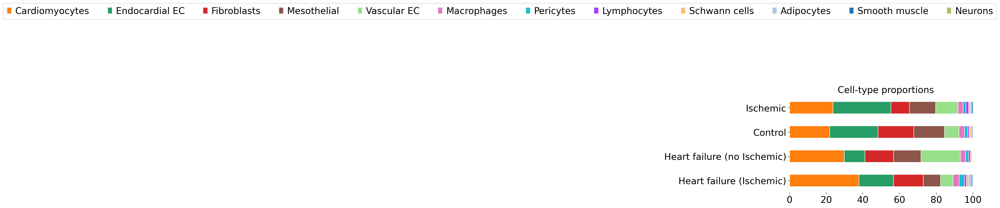

In [190]:
cell_types = ["Cardiomyocytes", "Endocardial EC", "Fibroblasts", "Mesothelial", "Vascular EC", "Macrophages", "Pericytes", "Lymphocytes", "Schwann cells", "Adipocytes", 
            "Smooth muscle", "Neurons"]
from matplotlib import pyplot as plt
font = {'size'   : 12}

matplotlib.rc('font', **font)

# Very simple one-liner using our agg_tips DataFrame.
rcParams['figure.figsize'] = 10,4
df.T.plot(kind='barh', stacked=True, legend = True, grid = False, color = colors, edgecolor = "w")

# Just add a title and rotate the x-axis labels to be horizontal.
plt.title('Cell-type proportions', fontsize = 20)
plt.xticks(rotation=0, ha='center', fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
for pos in ['right', 'top', 'bottom', 'left']: 
    plt.gca().spines[pos].set_visible(False) 
plt.legend(loc='best', bbox_to_anchor=(1.1, 0, 0, 2), ncol = 12, fontsize = 20)


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


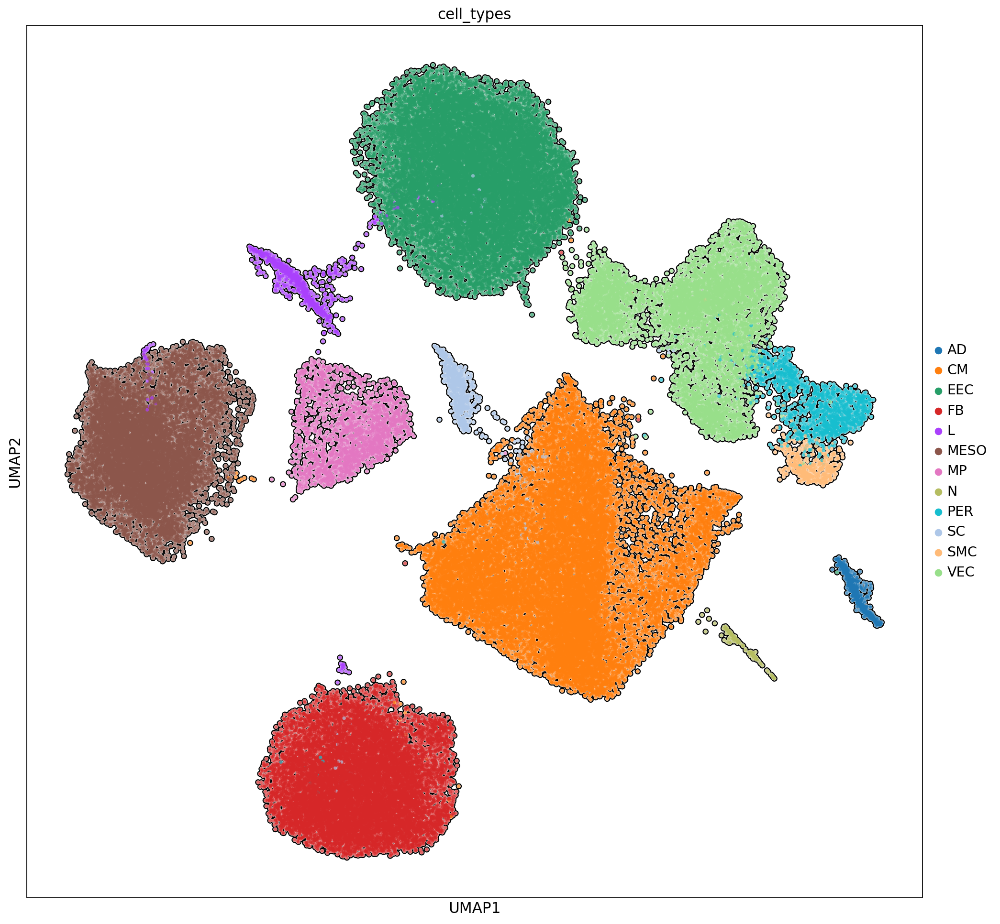

In [74]:
rcParams['figure.figsize'] = 15,15
sc.pl.umap(adata, color = "cell_types", size = 45,  add_outline=True)

... storing 'samples' as categorical


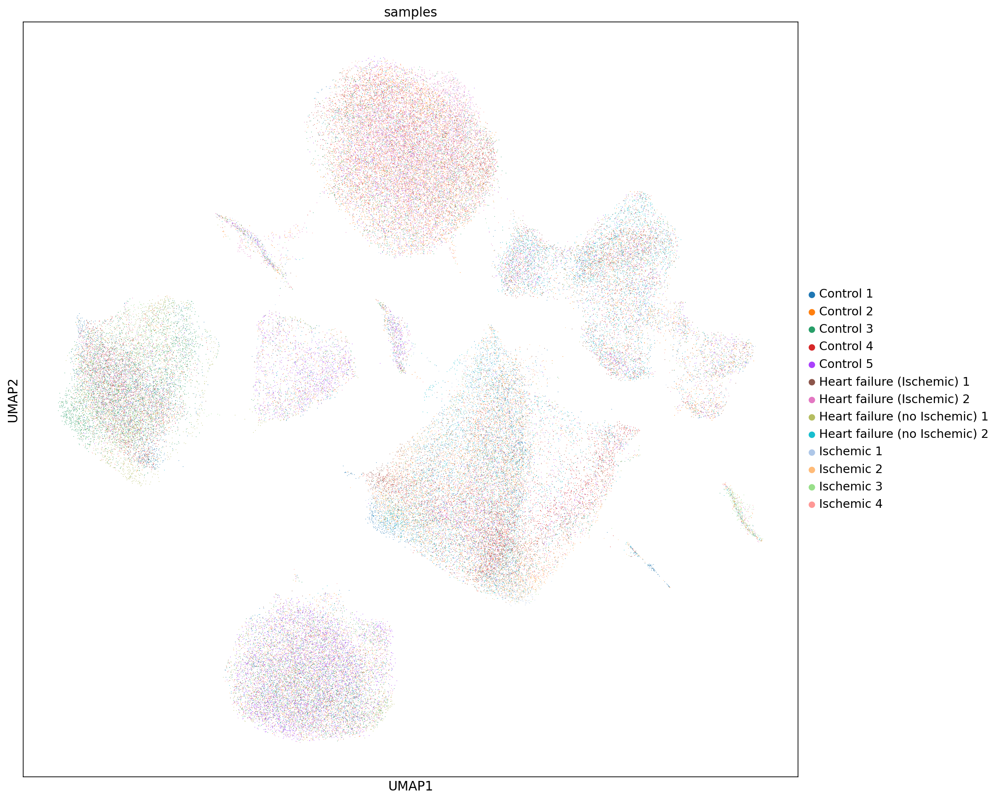

In [75]:
adata.obs['samples'] = adata.obs['sample_id'].astype(int).replace({1: 'Ischemic 1',16: 'Ischemic 2', 22: 'Ischemic 3', 174: "Heart failure (no Ischemic) 1", 281: "Heart failure (no Ischemic) 2",
                                                                        35: 'Control 1', 66: 'Control 2', 202: 'Control 3', 
                                                                        201: 'Ischemic 4', 234: 'Control 4', 170: 'Control 5', 58: 'Heart failure (Ischemic) 1', 91: "Heart failure (Ischemic) 2"})
sc.pl.umap(adata, color = ['samples'])

In [76]:
order = ['Control 1', 'Control 2', 'Control 3', 'Control 4', 'Control 5', 'Ischemic 1', 'Ischemic 2', 'Ischemic 3', 'Ischemic 4', 'Heart failure (Ischemic) 1', 'Heart failure (Ischemic) 2', 'Heart failure (no Ischemic) 1', 'Heart failure (no Ischemic) 2']
order.reverse()

In [77]:
adata.obs.samples = adata.obs.samples.cat.reorder_categories(order)

In [78]:
['Control 1', 'Control 2', 'Control 3', 'Control 4', 'Control 5', 'Ischemic 1', 'Ischemic 2', 'Ischemic 3', 'Ischemic 4', 'Heart failure (no Ischemic) 1', 'Heart failure (no Ischemic) 2', 
                                                              'Heart failure (Ischemic) 1', 'Heart failure (Ischemic) 2'].reverse()

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


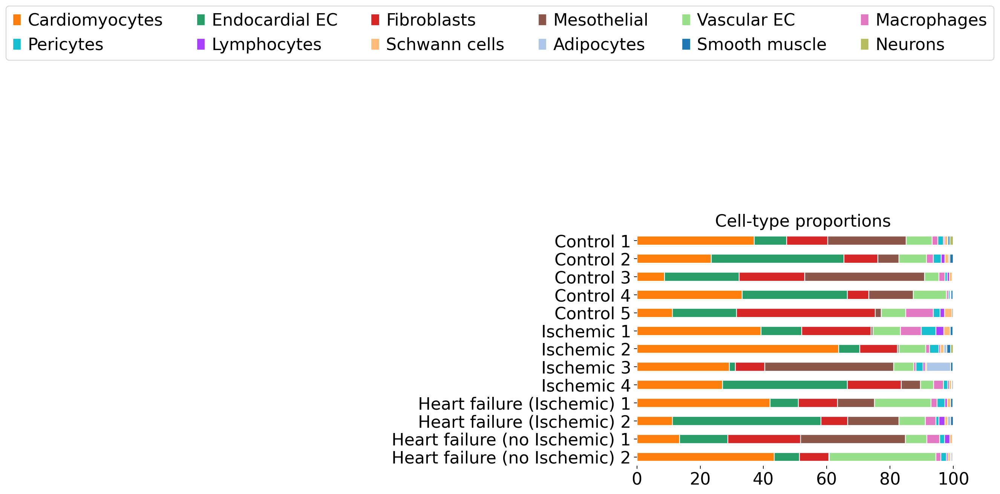

In [79]:
percentages = {}
for phenotype in adata.obs.samples.cat.categories.to_list():
    percentages[phenotype] = percentage(adata[adata.obs.samples == phenotype])
cell_types = ["Cardiomyocytes", "Endocardial EC", "Fibroblasts", "Mesothelial", "Vascular EC", "Macrophages", "Pericytes", "Lymphocytes", "Schwann cells", "Adipocytes", 
            "Smooth muscle", "Neurons"]
df = pd.DataFrame(percentages, index = cell_types)
from matplotlib import pyplot as plt

# Very simple one-liner using our agg_tips DataFrame.
rcParams['figure.figsize'] = 10,5
ax =df.T.plot(kind='barh', stacked=True, legend = True, grid = False, color = colors, edgecolor = "w")

# Just add a title and rotate the x-axis labels to be horizontal.
plt.title('Cell-type proportions', fontsize = 20)
plt.xticks(rotation=0, ha='center', fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
for pos in ['right', 'top', 'bottom', 'left']: 
    plt.gca().spines[pos].set_visible(False) 
handles,labels = ax.get_legend_handles_labels()
handles = [handles[0], handles[6], handles[1], handles[7], handles[2], handles[8], handles[3], handles[9],handles[4], handles[10],handles[5], handles[11]]
labels = [labels[0], labels[6], labels[1], labels[7], labels[2], labels[8], labels[3], labels[9],labels[4], labels[10],labels[5], labels[11]]
plt.legend(handles,labels, loc='best', bbox_to_anchor=(1.1, 0, 0, 2), ncol = 6, fontsize = 20)

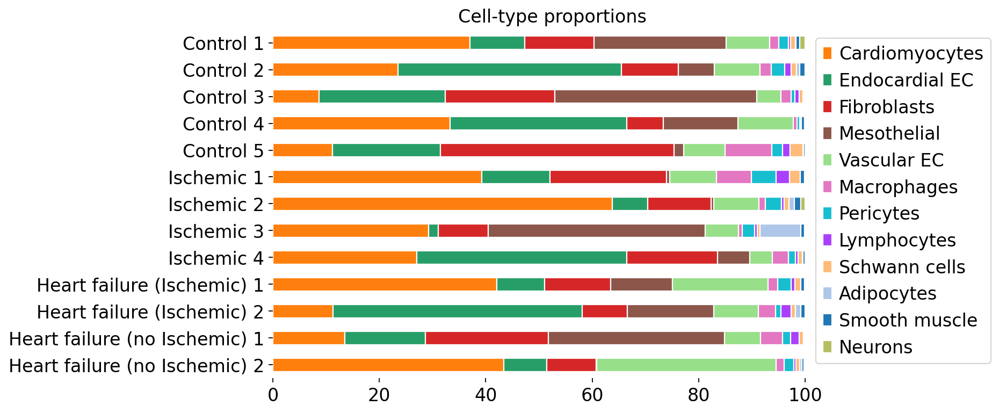

In [123]:
percentages = {}
for phenotype in adata.obs.samples.cat.categories.to_list():
    percentages[phenotype] = percentage(adata[adata.obs.samples == phenotype])
cell_types = ["Cardiomyocytes", "Endocardial EC", "Fibroblasts", "Mesothelial", "Vascular EC", "Macrophages", "Pericytes", "Lymphocytes", "Schwann cells", "Adipocytes", 
            "Smooth muscle", "Neurons"]
df = pd.DataFrame(percentages, index = cell_types)
from matplotlib import pyplot as plt
# Very simple one-liner using our agg_tips DataFrame.
rcParams['figure.figsize'] = 10,5
ax =df.T.plot(kind='barh', stacked=True, legend = True, grid = False, color = colors, edgecolor = "w")

# Just add a title and rotate the x-axis labels to be horizontal.
plt.title('Cell-type proportions', fontsize = 15)
plt.xticks(rotation=0, ha='center', fontsize = 15)
plt.yticks(fontsize = 15)
plt.tight_layout()
for pos in ['right', 'top', 'bottom', 'left']: 
    plt.gca().spines[pos].set_visible(False) 
plt.legend(loc='best', bbox_to_anchor=(1.3, 1, 0, 0), fontsize = 15)
plt.savefig("../figures/fig1/prop.pdf", bbox_inches='tight')

In [12]:
subadata = sc.read_h5ad('../h5ad/subadata_EC.h5ad')

In [13]:
subadata

AnnData object with n_obs × n_vars = 9662 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden', 'tentative_subtypes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt', 'cm'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'tentative_subtypes_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [14]:
rcParams['figure.figsize'] = 10,10

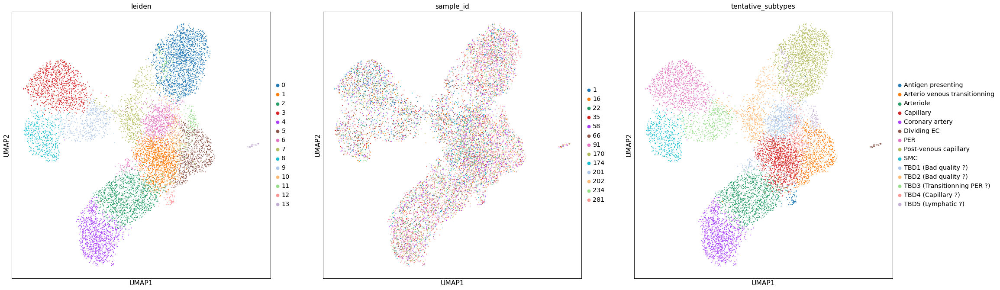

In [15]:
sc.pl.umap(subadata, color = ['leiden', 'sample_id', 'tentative_subtypes'])

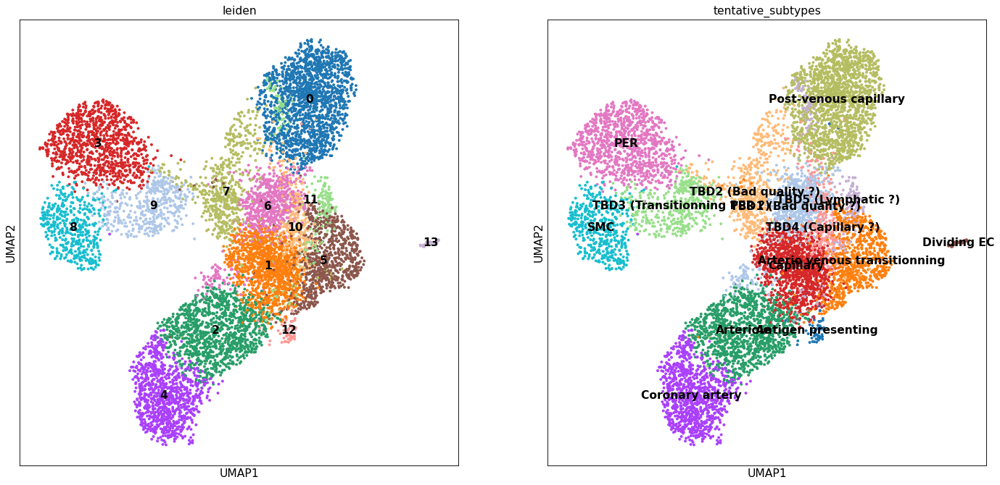

In [16]:
sc.pl.umap(subadata, color = ['leiden', 'tentative_subtypes'], legend_loc = "on data", size = 50)

In [20]:
subadata.obs['subtypes_full'] = subadata.obs['leiden'].astype(int).replace({0: 'Venous', 1: 'Capillary 1 (aortic*)',2: 'Arteriole', 3: 'Pericyte 1', 4: "Coronary artery", 5: "Capillary 2 (arterial*)",
                                                                        6: 'Capillary 3 (arterial*)', 7: 'Capillary 4 (venous*)', 8: 'Smooth muscle', 
                                                                        9: 'Pericyte 2 (arterial*, proliferating*)', 10: 'Capillary X (mix*, remove)', 11: 'Lymphatic', 12: 'Inflammatory', 13: "Dividing EC"})

In [21]:
subadata.obs['subtypes'] = subadata.obs['leiden'].astype(int).replace({0: 'VEN', 1: 'CAP1',2: 'ART', 3: 'PER1', 4: "CA", 5: "CAP2",
                                                                        6: 'CAP3', 7: 'CAP4', 8: 'SMC', 
                                                                        9: 'PER2', 10: 'CAPX', 11: 'LYM', 12: 'IF', 13: "DEC"})

... storing 'subtypes_full' as categorical
... storing 'subtypes' as categorical


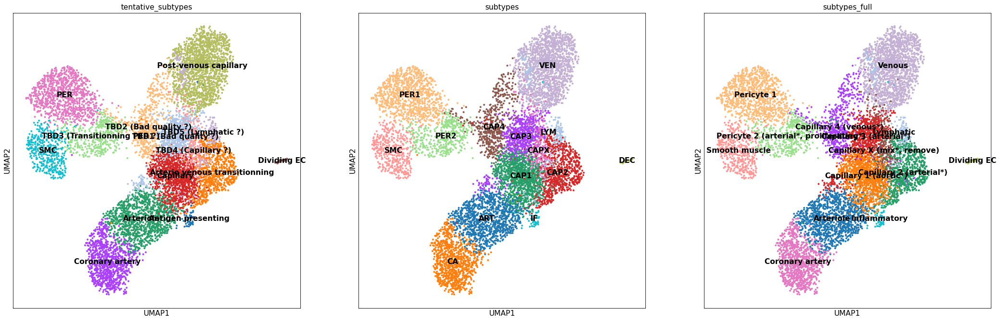

In [22]:
sc.pl.umap(subadata, color = ['tentative_subtypes', "subtypes", "subtypes_full"], legend_loc = "on data", size = 50)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_subtypes']`


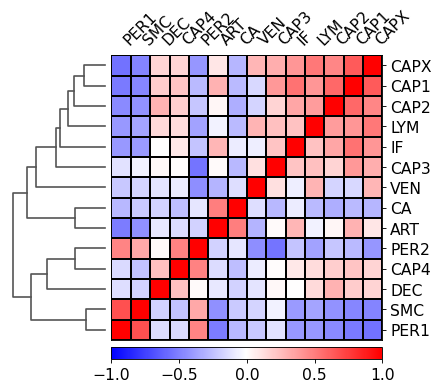

In [23]:
ax = sc.pl.correlation_matrix(subadata, 'subtypes', figsize = (6,5))

running Leiden clustering
    finished: found 25 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


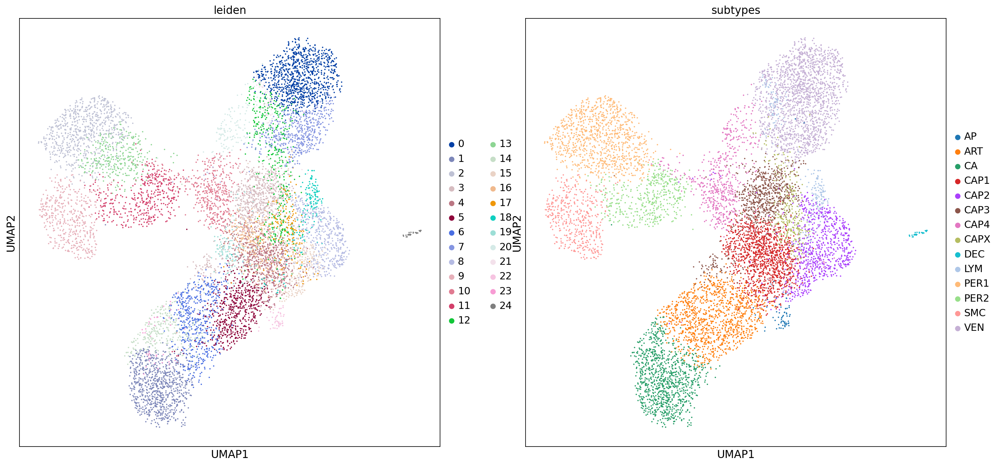

In [17]:
subadata2 = subadata.copy()
sc.tl.leiden(subadata2, resolution = 2)
sc.pl.umap(subadata2, color = ['leiden', 'subtypes'])

In [209]:
subadata2.obs.leiden.value_counts()

0     959
1     799
2     704
3     658
4     624
5     557
6     551
7     500
8     486
9     456
10    441
11    428
12    394
13    319
14    315
15    314
16    293
17    186
18    163
19    149
20    141
21     84
22     65
23     47
24     29
Name: leiden, dtype: int64

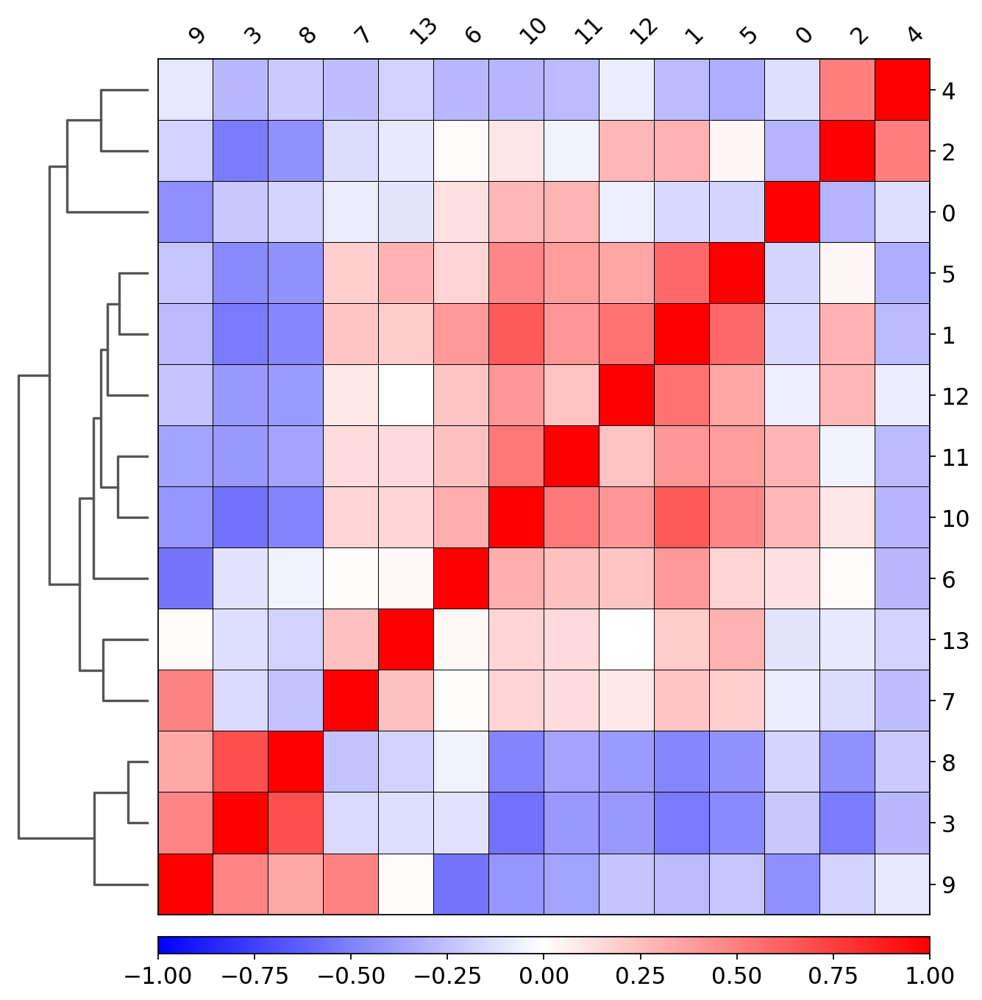

In [210]:
ax = sc.pl.correlation_matrix(subadata2, 'leiden', figsize = (10,10))

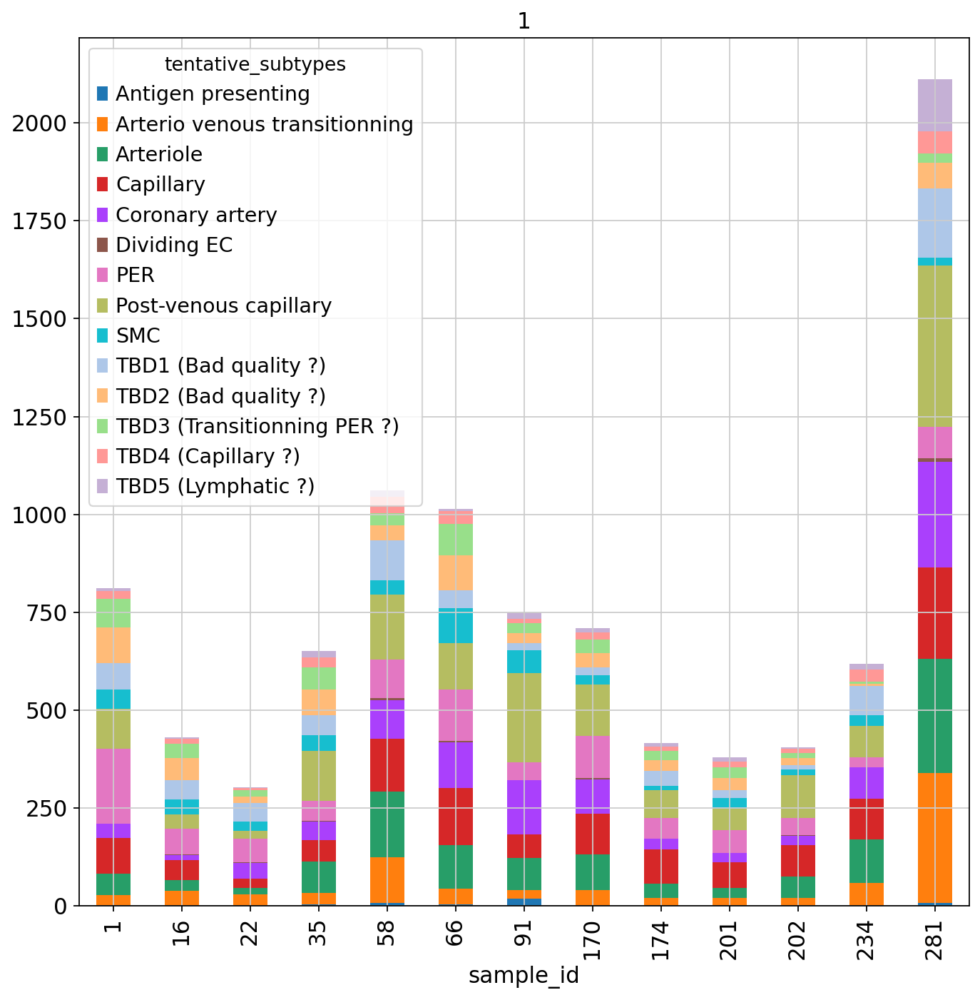

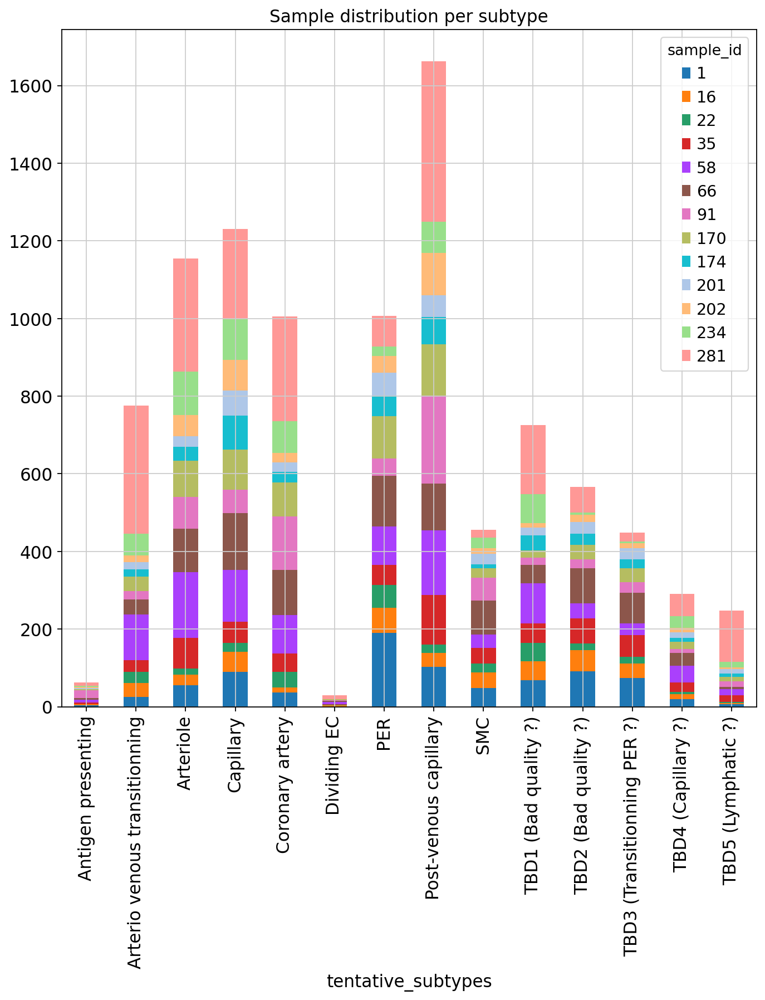

In [211]:
test = subadata.obs.groupby(['tentative_subtypes','sample_id']).size().unstack(fill_value=0)
test.columns = test.columns.astype('str')
#test.insert(0, "All", test.sum(axis = 1), True)
test.T.plot.bar(stacked=True, title="1");
test.plot.bar(stacked=True, title="Sample distribution per subtype");

Visualize markers from previous annot <a name='markers_1' />

ranking genes


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:01:09)


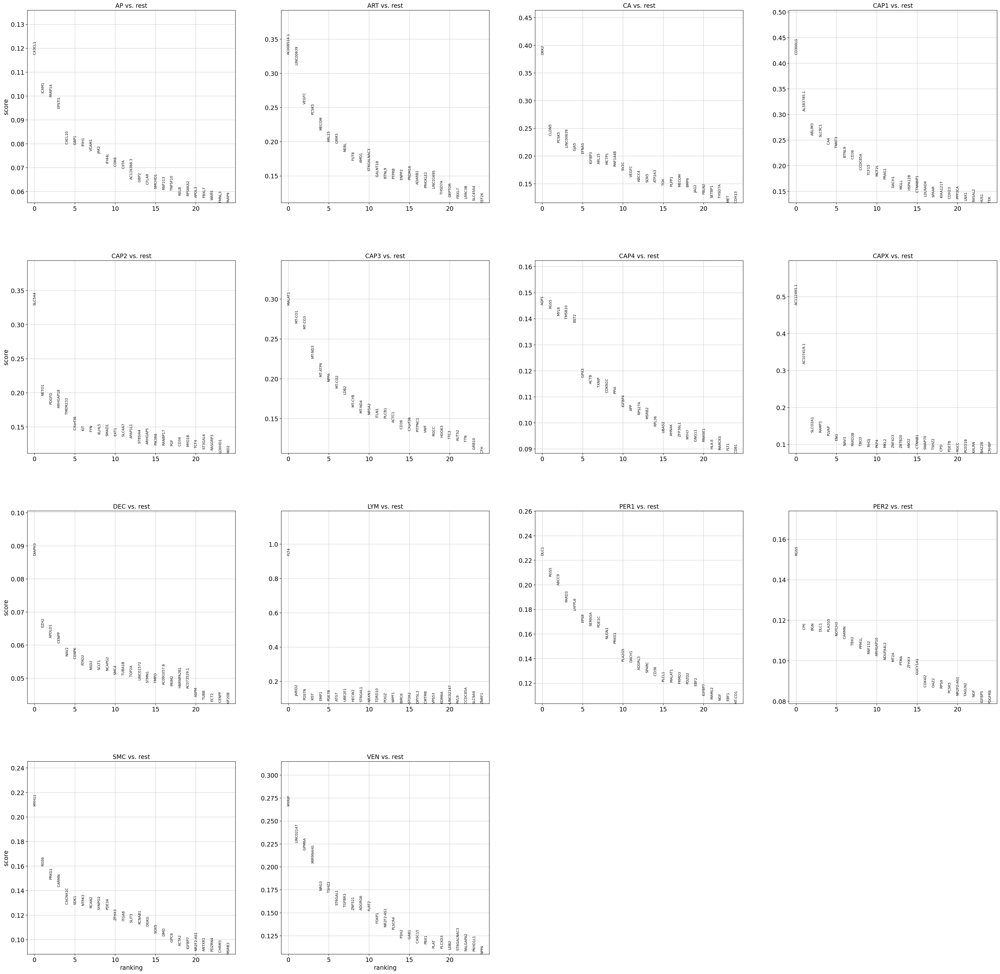

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


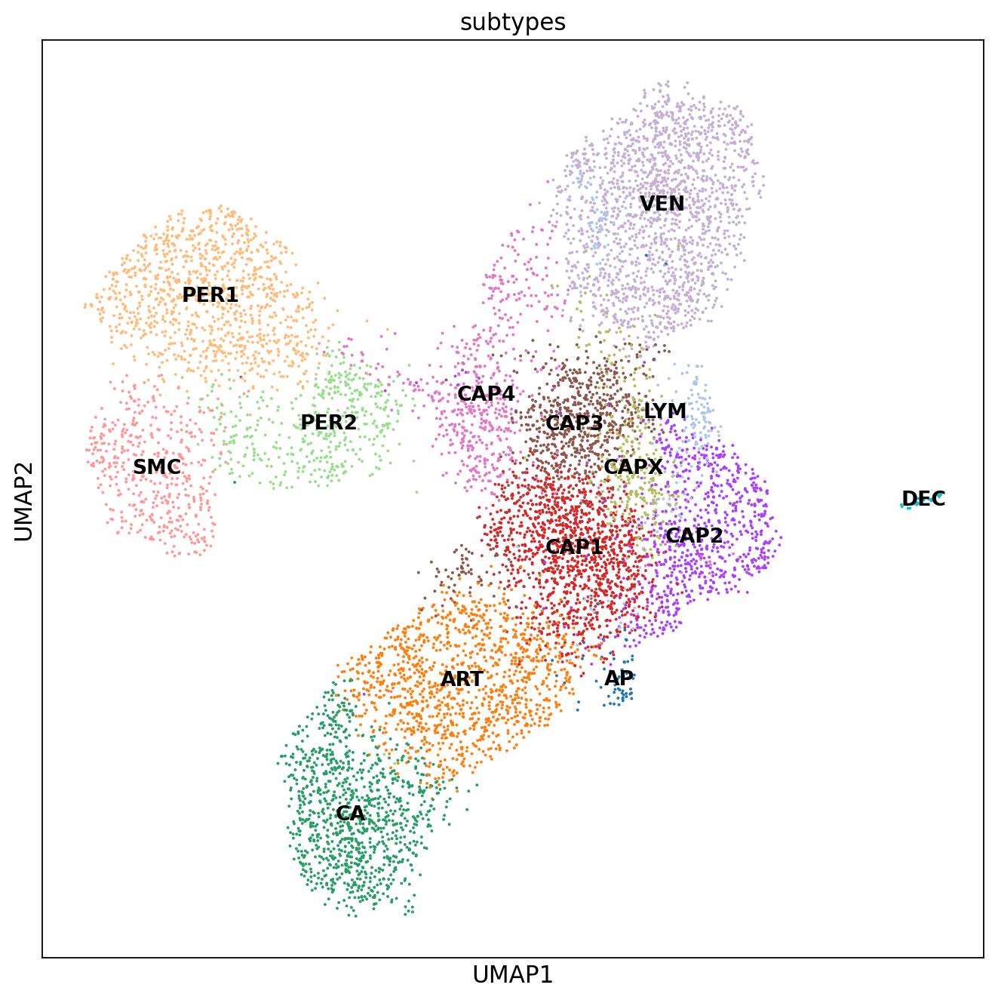

,AP,ART,CA,CAP1,CAP2,CAP3,CAP4,CAPX,DEC,LYM,PER1,PER2,SMC,VEN
0,CX3CL1,AC008514.1,DKK2,CD300LG,SLC5A4,MALAT1,AQP1,AC112493.1,DIAPH3,FLT4,DLC1,RGS5,MYH11,MYRIP
1,ICAM1,LINC00639,CLDN5,AL583785.1,NETO1,MT-CO1,RGS5,AC107419.1,EZH2,JARID2,RGS5,CPE,RGS6,LINC02147
2,PARP14,VEGFC,PCSK5,ABLIM3,PDGFD,MT-CO3,MYL6,SLCO2A1,APOLD1,POSTN,ABCC9,BGN,PRKG1,GPM6A
3,EPSTI1,PCSK5,LINC00639,SLC9C1,ARHGAP18,MT-ND3,TMSB10,RAMP3,CENPP,XIST,PARD3,DLC1,CARMN,MIR99AHG
4,CXCL10,MECOM,GJA5,CA4,TMEM233,MT-ATP6,BST2,PLVAP,NAV2,EMP1,LHFPL6,PLA2G5,CACNA1C,NRG3
5,GBP1,ARL15,EFNA5,TNNT3,CXorf36,NPPA,GPX3,ENG,CENPK,PDE7B,EPS8,NOTCH3,SDK1,TSHZ2
6,IFIH1,GRM3,IGFBP3,BTNL9,KIT,MT-CO2,ACTB,NAV3,ATAD2,ATG7,SEMA5A,CARMN,NTRK3,ST6GAL1
7,VCAM1,NEBL,ARL15,CD36,FYN,LDB2,TXNIP,PARD3B,NSD2,UBE2E1,PDE1C,TBX2,RCAN2,TGFBR3
8,JAK2,FUT8,MCTP1,CCDC85A,KLHL5,MT-CYB,CDKN1C,TBCD,SCLT1,HECW2,NLGN1,PPM1L,SYNPO2,ZNF521
9,IFI44L,AMD1,RNF144B,TCF15,SMAD1,MT-ND4,PPIA,RHOJ,NCAPG2,ST6GAL1,PRKG1,RNF152,PDE3A,ADGRG6


In [212]:
sc.tl.rank_genes_groups(subadata, 'subtypes', method='logreg', n_genes = 1000)
sc.pl.rank_genes_groups(subadata, n_genes=25, sharey=False)

sc.pl.umap(subadata, color = 'subtypes', legend_loc = 'on data')

pd.DataFrame(subadata.uns['rank_genes_groups']['names']).head(25)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['subtypes']"]`
categories: AP, ART, CA, etc.
var_group_labels: VC_EC, AC_EC, C_EC, etc.


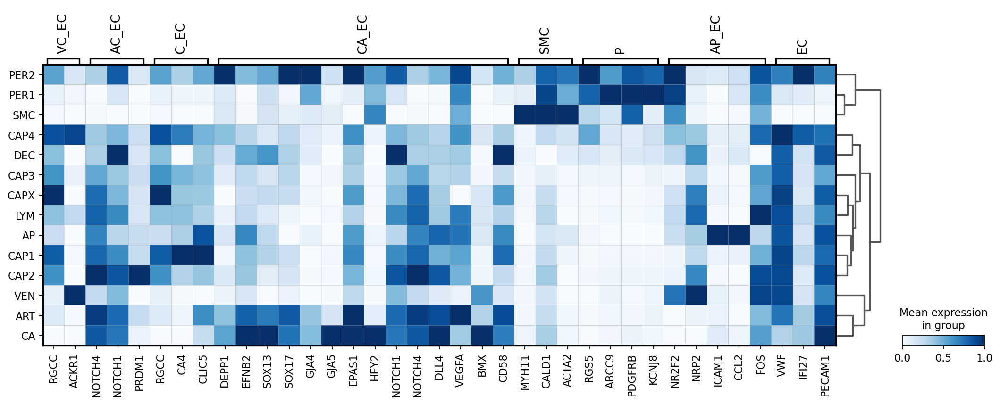

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: VC_EC, AC_EC, C_EC, etc.


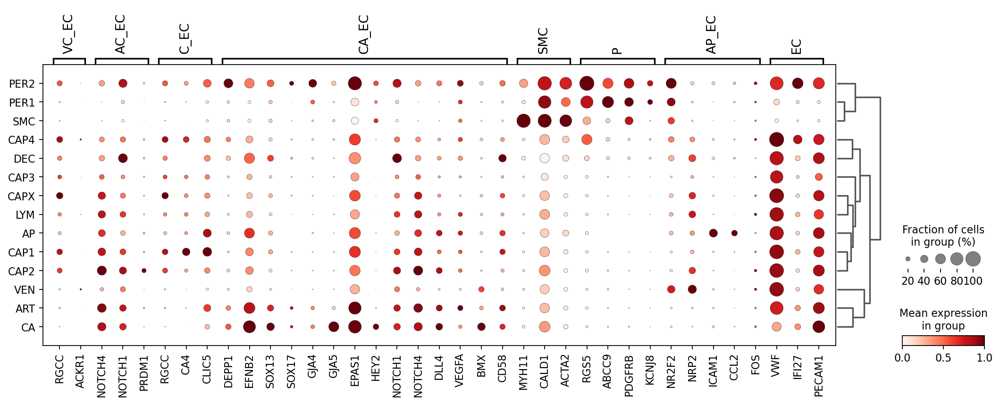

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: VC_EC, AC_EC, C_EC, etc.


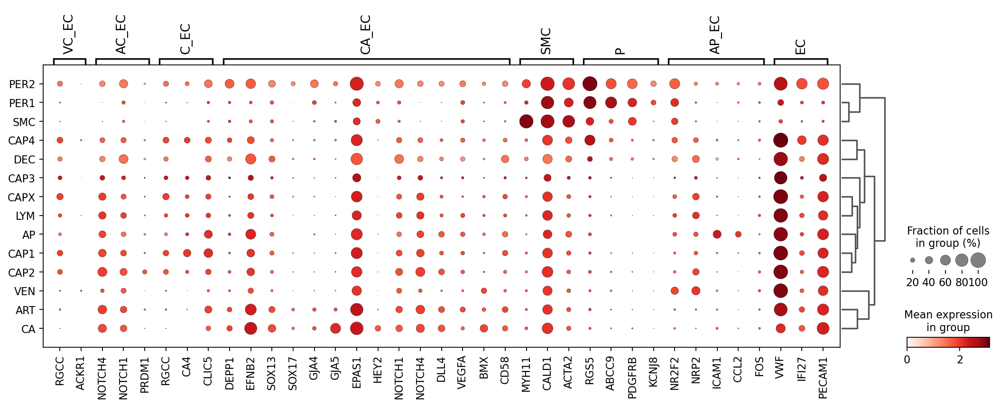

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


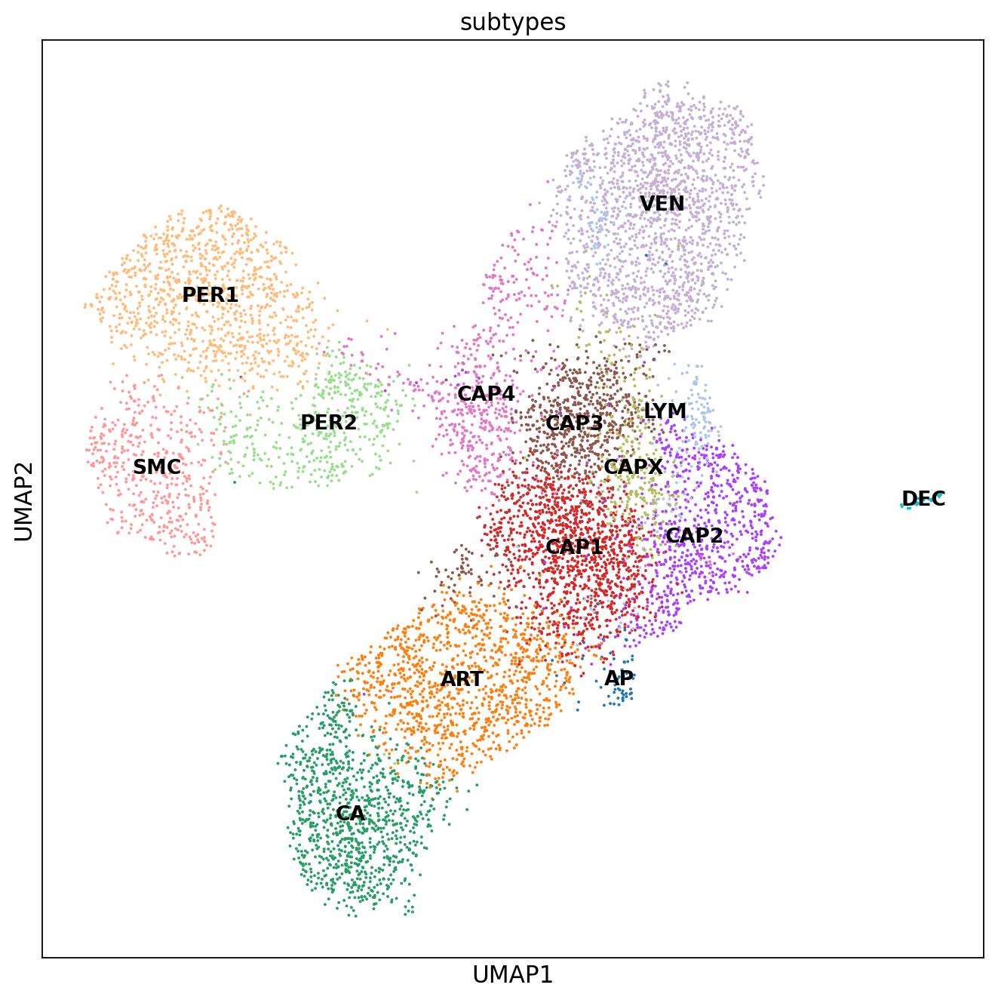

In [85]:
#sc.pl.umap(adata, color= 'leiden')
#sc.pl.matrixplot(adata, var_names = ['VWF', 'PECAM1'], groupby = 'leiden', use_raw = True)
markers_all = ['RGCC', 'ACKR1', 
               'NOTCH4', 'NOTCH1', 'PRDM1',
               'RGCC', 'CA4', 'CLIC5',
               "DEPP1", "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2", "NOTCH1"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "CD58",
               "MYH11", "CALD1", "ACTA2", 
               "RGS5", "ABCC9", "PDGFRB", "KCNJ8",
               'NR2F2', 'NRP2', 'ICAM1', 'CCL2', 'FOS',
              "VWF", "IFI27", "PECAM1"]
markers_groups = [(0,1), (2,4), (5,7), (8,21), (22,24), (25,28), (29, 33), (34, 36)]
markers_groups_names = ["VC_EC", "AC_EC", "C_EC", "CA_EC", "SMC", "P", 'AP_EC', 'EC']
sc.tl.dendrogram(subadata, 'leiden')
#sc.pl.matrixplot(adata, markers_all, groupby = "batch")
sc.pl.matrixplot(subadata, var_names = markers_all, groupby = "subtypes", use_raw = True, 
               standard_scale = "var", var_group_positions = markers_groups, 
                var_group_labels = markers_groups_names,
               cmap = "Blues", save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, var_names = markers_all, groupby = "subtypes", use_raw = True, 
               standard_scale = "var", var_group_positions = markers_groups, 
                var_group_labels = markers_groups_names,
               save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, var_names = markers_all, groupby = "subtypes", use_raw = True, 
                var_group_positions = markers_groups, 
                var_group_labels = markers_groups_names,
               save="heatmap.png", dendrogram = True, mean_only_expressed = True)
sc.pl.umap(subadata, color = 'subtypes', legend_loc = 'on data')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_subtypes']`
categories: ART, CA, CAP1, etc.
var_group_labels: AC_EC, PVC_EC, CA_EC, etc.


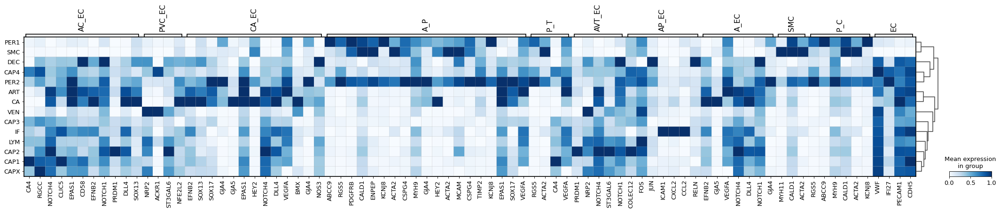

categories: ART, CA, CAP1, etc.
var_group_labels: AC_EC, PVC_EC, CA_EC, etc.


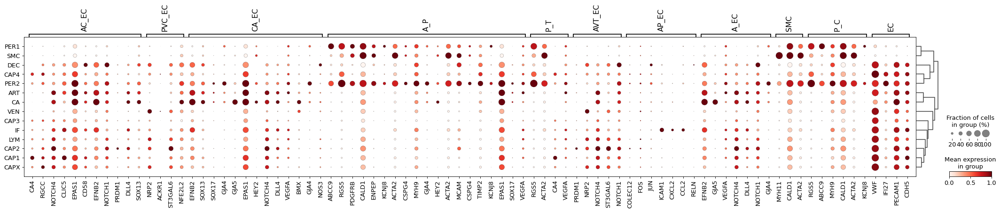

categories: ART, CA, CAP1, etc.
var_group_labels: AC_EC, PVC_EC, CA_EC, etc.


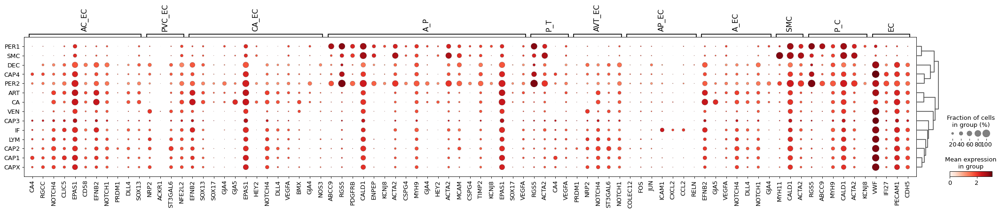

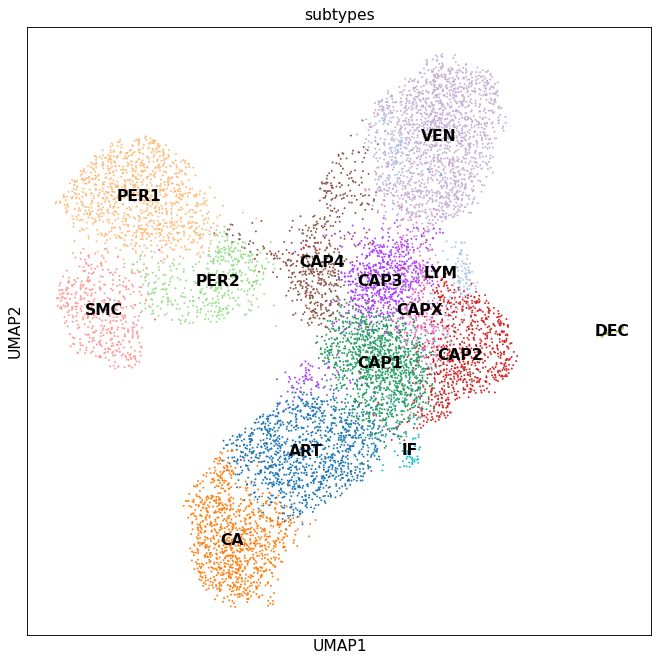

In [28]:
#sc.tl.leiden(subadata, resolution = 1)
markers_all = ['CA4', 'RGCC', 'NOTCH4', 'CLIC5', 'EPAS1', 'CD58', 'EFNB2', 'NOTCH1', 'PRDM1', "DLL4", "SOX13",
               'NRP2', 'ACKR1', 'ST3GAL6', 'NFE2L2',
               "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "GJA4", "NOS3",
               "ABCC9", "RGS5", "PDGFRB", "CALD1", "ENPEP", "KCNJ8", "ACTA2", "CSPG4", "MYH9", "GJA4", "HEY2", 
                   "ACTA2", "MCAM", "CSPG4", "TIMP2", "KCNJ8", "EPAS1", "SOX17", "VEGFA",
               "RGS5", "ACTA2", "CA4", "VEGFA",
               "PRDM1", "NRP2", "NOTCH4", "ST3GAL6", "NOTCH1",
               "COLEC12", "FOS", "JUN", "ICAM1", "CXCL2", "CCL2", "RELN",
               "EFNB2", "GJA5", "VEGFA", "NOTCH4", "DLL4", "NOTCH1", "GJA4",
               "MYH11", "CALD1", "ACTA2",
                "RGS5", "ABCC9", "MYH9", "CALD1", "ACTA2", "KCNJ8",
              "VWF", "IFI27", "PECAM1", "CDH5"]
markers_groups = [(0,10), (11,14), (15,27), (28,46), (47,50), (51,55), 
                  (56, 62), (63, 69), (70, 72), (73, 78), (79,82)]
markers_groups_names = ["AC_EC", "PVC_EC", "CA_EC", "A_P", "P_T", "AVT_EC", "AP_EC", "A_EC", "SMC", "P_C", 'EC']
#new_cell_type_names = ["Arterial Capillary EC (AP_EC)", "Post-capillary Venous EC (PCV_EC)", 
#                        "Coronary Artery EC (CA_EC)", "Arterial Pericyte (A_P)", 
#                            "Pericyte (Transitionnal), (P_T)", "A/V Transitionnal EC (AVT_EC)",
#                        "Antigen Presenting EC (AP_EC)", "Arterial (arteriole) EC (A_EC)", "Smooth Muscle Cell (SMC)",
#                      "Pericyte Capillary (P_C)", "Other EC (EC)"]
#subadata.rename_categories('subtype', new_cell_type_names)
sc.tl.dendrogram(subadata, groupby='subtypes')
sc.pl.matrixplot(subadata, markers_all, groupby = "subtypes", use_raw = True, 
                 standard_scale = "var", var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 cmap = "Blues", save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, markers_all, groupby = "subtypes", use_raw = True, 
                 standard_scale = "var", var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, markers_all, groupby = "subtypes", use_raw = True, 
                 var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 save="heatmap.png", dendrogram = True, mean_only_expressed = True)
sc.pl.umap(subadata, color = 'subtypes', legend_loc = 'on data')

Remove uncertain groups + recluster <a name='reclustering' />

In [29]:
subadata = subadata[~subadata.obs.subtypes.isin(['DEC', 'CAPX'])]

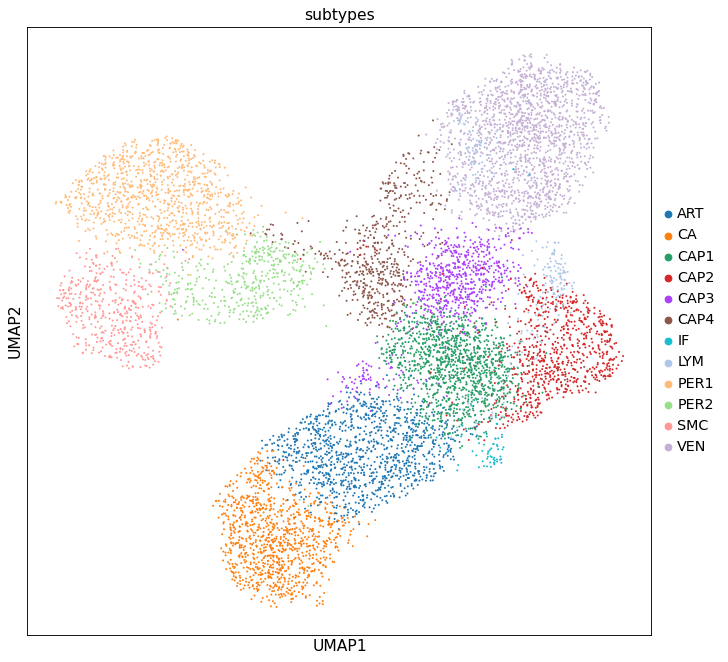

In [30]:
sc.pl.umap(subadata, color = 'subtypes')

In [31]:
sc.pp.neighbors(subadata, n_neighbors=10, n_pcs=40)
sc.tl.umap(subadata)
sc.tl.leiden(subadata, resolution = 1)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [14]:
rcParams['figure.figsize'] = 5,5

In [ ]:
sc.pl.umap(subadata, color = ['leiden', 'subtypes'])

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['subtypes']"]`
categories: AP, ART, CA, etc.
var_group_labels: VC_EC, AC_EC, C_EC, etc.


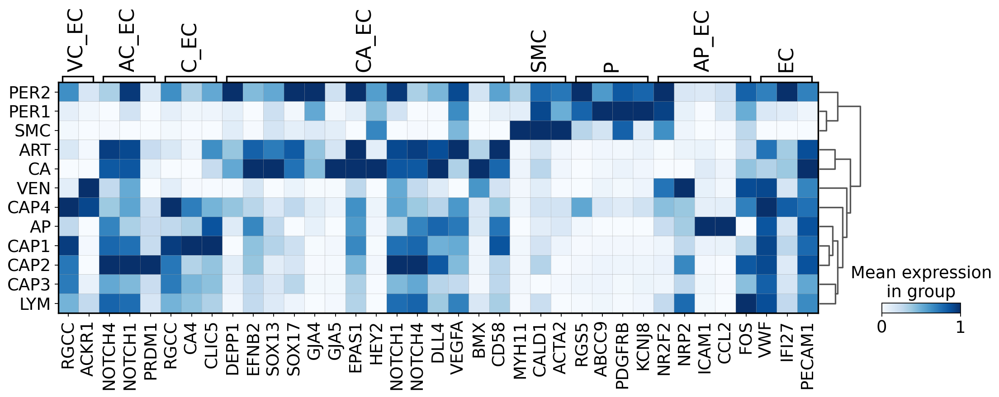

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: VC_EC, AC_EC, C_EC, etc.


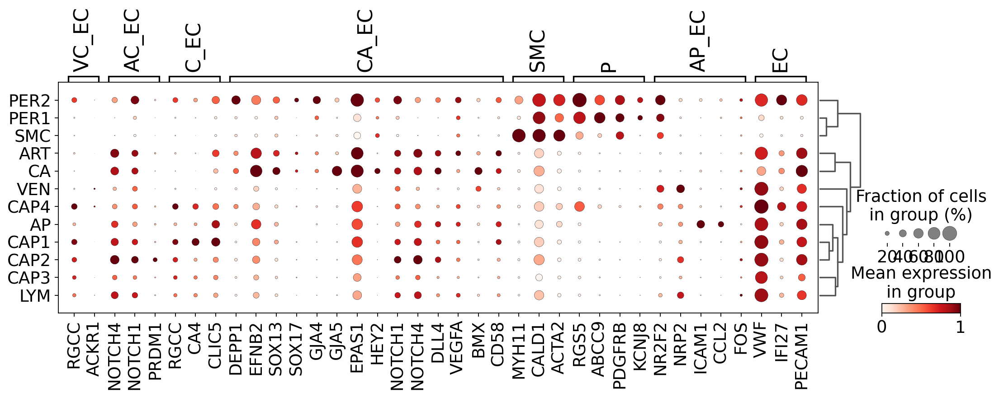

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: VC_EC, AC_EC, C_EC, etc.


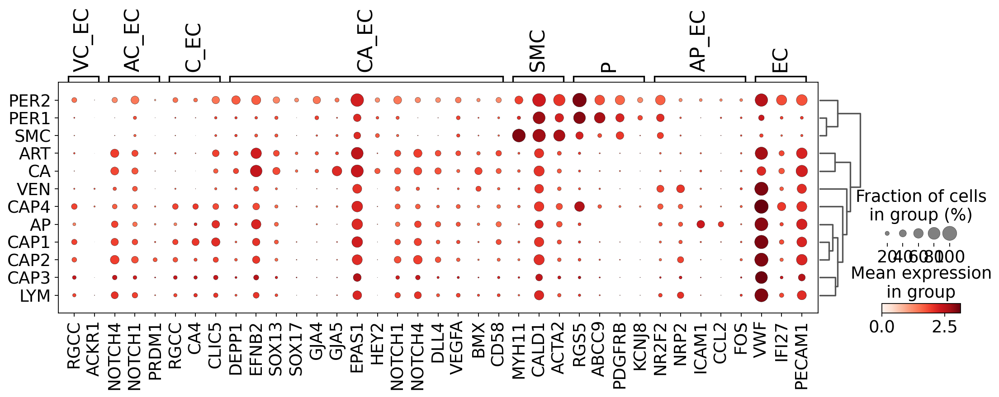

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


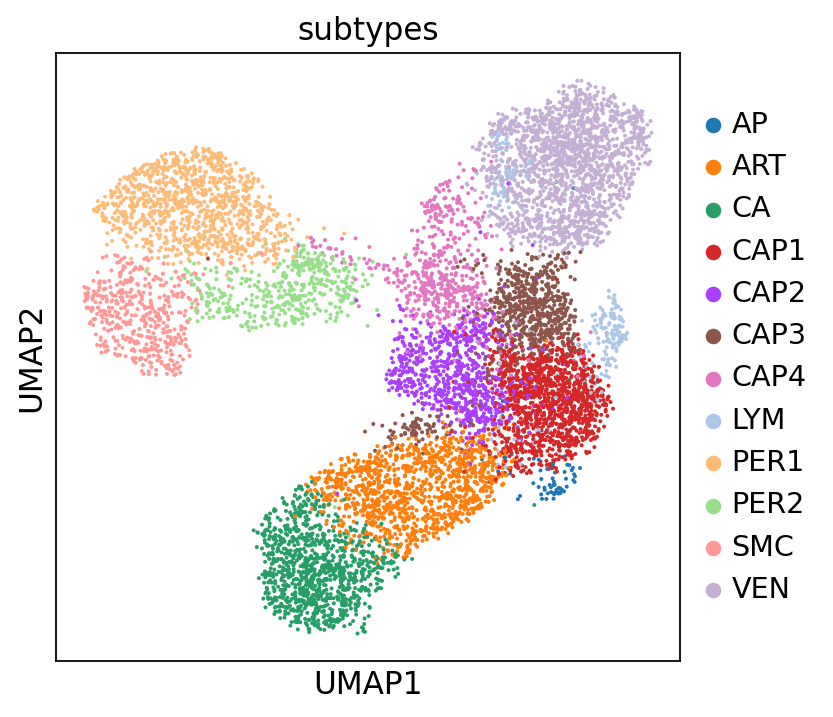

In [224]:
group = 'subtypes'
#sc.pl.umap(adata, color= 'leiden')
#sc.pl.matrixplot(adata, var_names = ['VWF', 'PECAM1'], groupby = 'leiden', use_raw = True)
group = 'subtypes'
markers_all = ['RGCC', 'ACKR1', 
               'NOTCH4', 'NOTCH1', 'PRDM1',
               'RGCC', 'CA4', 'CLIC5',
               "DEPP1", "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2", "NOTCH1"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "CD58",
               "MYH11", "CALD1", "ACTA2", 
               "RGS5", "ABCC9", "PDGFRB", "KCNJ8",
               'NR2F2', 'NRP2', 'ICAM1', 'CCL2', 'FOS',
              "VWF", "IFI27", "PECAM1"]
markers_groups = [(0,1), (2,4), (5,7), (8,21), (22,24), (25,28), (29, 33), (34, 36)]
markers_groups_names = ["VC_EC", "AC_EC", "C_EC", "CA_EC", "SMC", "P", 'AP_EC', 'EC']
sc.tl.dendrogram(subadata, group)
#sc.pl.matrixplot(adata, markers_all, groupby = "batch")
sc.pl.matrixplot(subadata, var_names = markers_all, groupby = group, use_raw = True, 
               standard_scale = "var", var_group_positions = markers_groups, 
                var_group_labels = markers_groups_names,
               cmap = "Blues", save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, var_names = markers_all, groupby = group, use_raw = True, 
               standard_scale = "var", var_group_positions = markers_groups, 
                var_group_labels = markers_groups_names,
               save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, var_names = markers_all, groupby = group, use_raw = True, 
                var_group_positions = markers_groups, 
                var_group_labels = markers_groups_names,
               save="heatmap.png", dendrogram = True, mean_only_expressed = True)
sc.pl.umap(subadata, color = group)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['subtypes']"]`
categories: AP, ART, CA, etc.
var_group_labels: AC_EC, PVC_EC, CA_EC, etc.


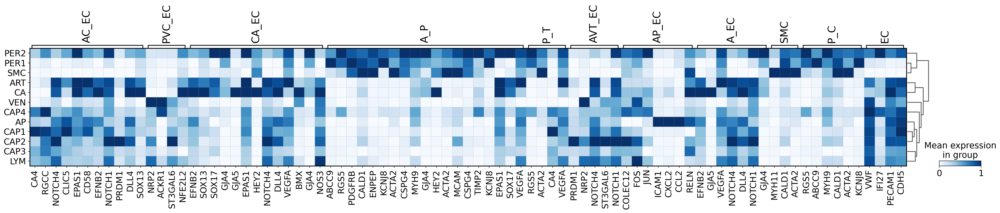

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: AC_EC, PVC_EC, CA_EC, etc.


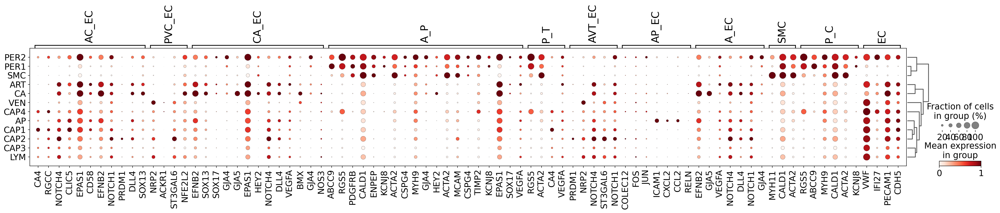

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: AC_EC, PVC_EC, CA_EC, etc.


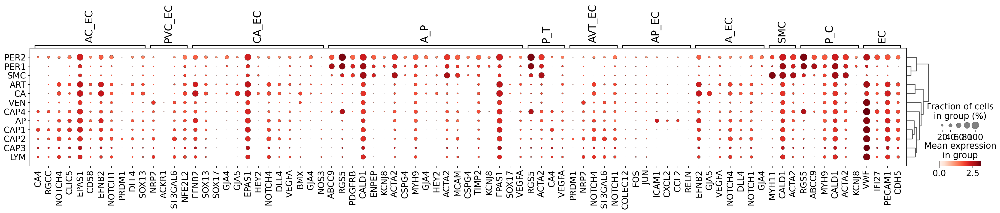

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


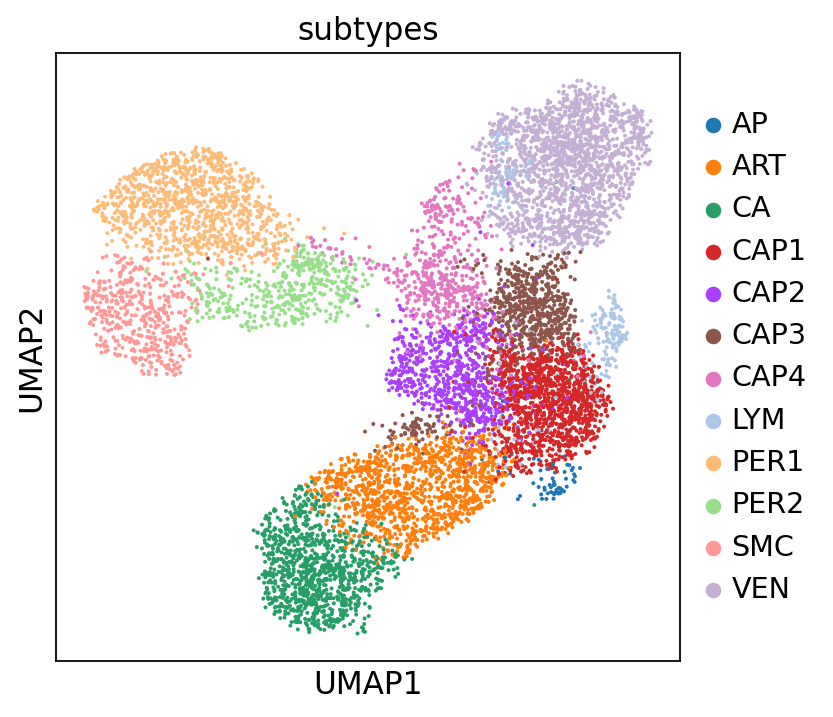

In [225]:
#sc.tl.leiden(subadata, resolution = 1)
markers_all = ['CA4', 'RGCC', 'NOTCH4', 'CLIC5', 'EPAS1', 'CD58', 'EFNB2', 'NOTCH1', 'PRDM1', "DLL4", "SOX13",
               'NRP2', 'ACKR1', 'ST3GAL6', 'NFE2L2',
               "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "GJA4", "NOS3",
               "ABCC9", "RGS5", "PDGFRB", "CALD1", "ENPEP", "KCNJ8", "ACTA2", "CSPG4", "MYH9", "GJA4", "HEY2", 
                   "ACTA2", "MCAM", "CSPG4", "TIMP2", "KCNJ8", "EPAS1", "SOX17", "VEGFA",
               "RGS5", "ACTA2", "CA4", "VEGFA",
               "PRDM1", "NRP2", "NOTCH4", "ST3GAL6", "NOTCH1",
               "COLEC12", "FOS", "JUN", "ICAM1", "CXCL2", "CCL2", "RELN",
               "EFNB2", "GJA5", "VEGFA", "NOTCH4", "DLL4", "NOTCH1", "GJA4",
               "MYH11", "CALD1", "ACTA2",
                "RGS5", "ABCC9", "MYH9", "CALD1", "ACTA2", "KCNJ8",
              "VWF", "IFI27", "PECAM1", "CDH5"]
markers_groups = [(0,10), (11,14), (15,27), (28,46), (47,50), (51,55), 
                  (56, 62), (63, 69), (70, 72), (73, 78), (79,82)]
markers_groups_names = ["AC_EC", "PVC_EC", "CA_EC", "A_P", "P_T", "AVT_EC", "AP_EC", "A_EC", "SMC", "P_C", 'EC']
#new_cell_type_names = ["Arterial Capillary EC (AP_EC)", "Post-capillary Venous EC (PCV_EC)", 
#                        "Coronary Artery EC (CA_EC)", "Arterial Pericyte (A_P)", 
#                            "Pericyte (Transitionnal), (P_T)", "A/V Transitionnal EC (AVT_EC)",
#                        "Antigen Presenting EC (AP_EC)", "Arterial (arteriole) EC (A_EC)", "Smooth Muscle Cell (SMC)",
#                      "Pericyte Capillary (P_C)", "Other EC (EC)"]
#subadata.rename_categories('subtype', new_cell_type_names)
sc.tl.dendrogram(subadata, groupby='subtypes')
sc.pl.matrixplot(subadata, markers_all, groupby = "subtypes", use_raw = True, 
                 standard_scale = "var", var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 cmap = "Blues", save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, markers_all, groupby = "subtypes", use_raw = True, 
                 standard_scale = "var", var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, markers_all, groupby = "subtypes", use_raw = True, 
                 var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 save="heatmap.png", dendrogram = True, mean_only_expressed = True)
sc.pl.umap(subadata, color = 'subtypes')

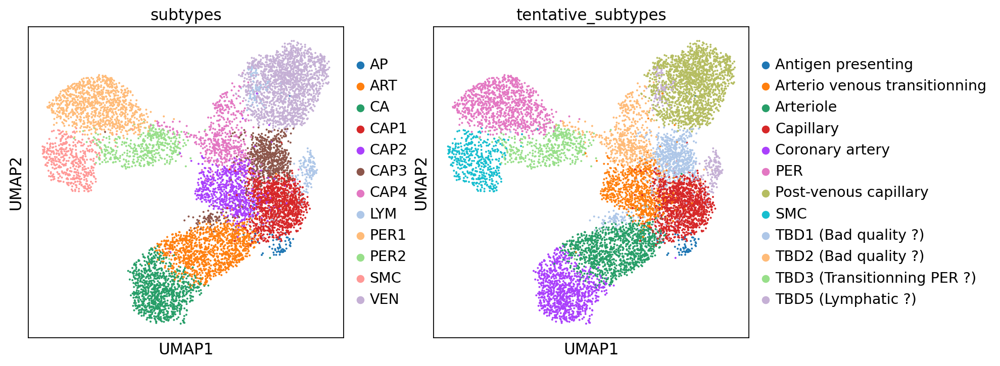

In [226]:
sc.pl.umap(subadata, color = ['subtypes', 'tentative_subtypes'])

ranking genes


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:58)


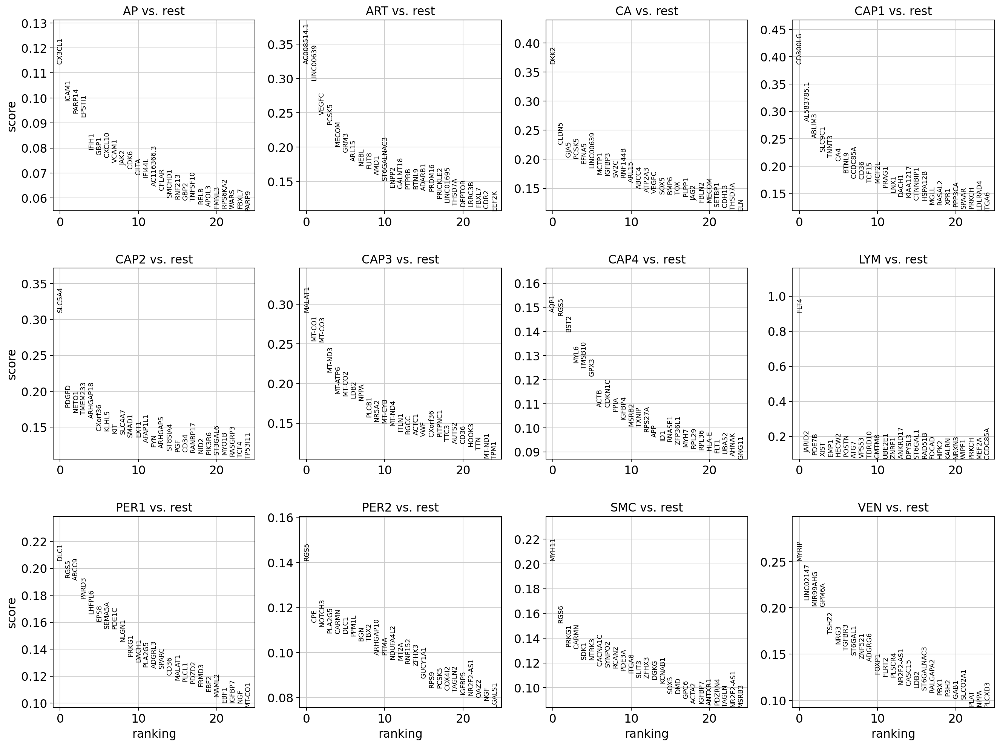

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


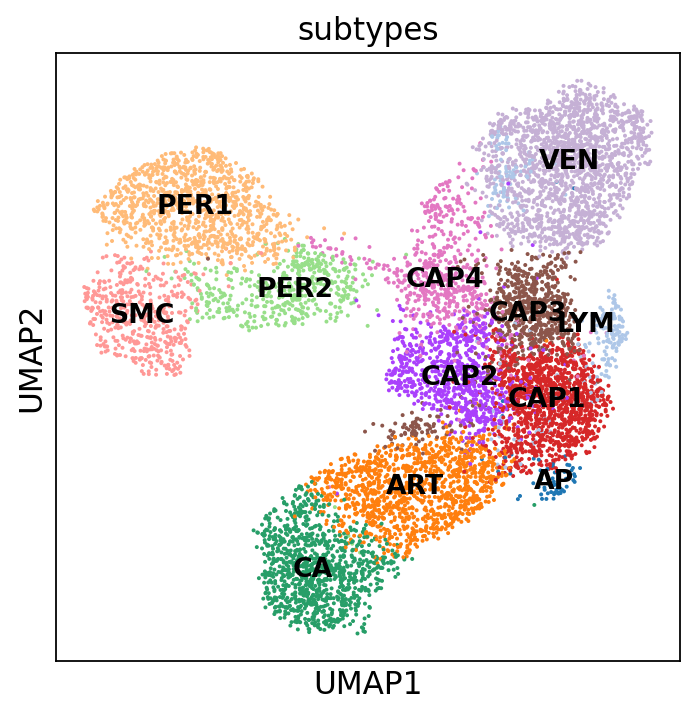

,AP,ART,CA,CAP1,CAP2,CAP3,CAP4,LYM,PER1,PER2,SMC,VEN
0,CX3CL1,AC008514.1,DKK2,CD300LG,SLC5A4,MALAT1,AQP1,FLT4,DLC1,RGS5,MYH11,MYRIP
1,ICAM1,LINC00639,CLDN5,AL583785.1,PDGFD,MT-CO1,RGS5,JARID2,RGS5,CPE,RGS6,LINC02147
2,PARP14,VEGFC,GJA5,ABLIM3,NETO1,MT-CO3,BST2,PDE7B,ABCC9,NOTCH3,PRKG1,MIR99AHG
3,EPSTI1,PCSK5,PCSK5,SLC9C1,TMEM233,MT-ND3,MYL6,XIST,PARD3,PLA2G5,CARMN,GPM6A
4,IFIH1,MECOM,EFNA5,TNNT3,ARHGAP18,MT-ATP6,TMSB10,EMP1,LHFPL6,CARMN,SDK1,TSHZ2
5,GBP1,GRM3,LINC00639,CA4,CXorf36,MT-CO2,GPX3,HECW2,EPS8,DLC1,NTRK3,NRG3
6,CXCL10,ARL15,MCTP1,BTNL9,KLHL5,LDB2,ACTB,POSTN,SEMA5A,PPM1L,CACNA1C,TGFBR3
7,VCAM1,NEBL,IGFBP3,CCDC85A,KIT,NPPA,CDKN1C,ATG7,PDE1C,BGN,SYNPO2,ST6GAL1
8,JAK2,FUT8,SV2C,CD36,SLC4A7,PLCB1,PPIA,VPS53,NLGN1,TBX2,RCAN2,ZNF521
9,CDK6,AMD1,RNF144B,TCF15,SMAD1,NR5A2,IGFBP4,TDRD10,PRKG1,ARHGAP10,PDE3A,ADGRG6


In [94]:
sc.tl.rank_genes_groups(subadata, 'subtypes', method='logreg', n_genes = 1000)
sc.pl.rank_genes_groups(subadata, n_genes=25, sharey=False)
sc.pl.umap(subadata, color = 'subtypes', legend_loc = 'on data')

pd.DataFrame(subadata.uns['rank_genes_groups']['names']).head(25)

Marker genes from final groups <a name='markers_2' />

ranking genes


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:59)


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


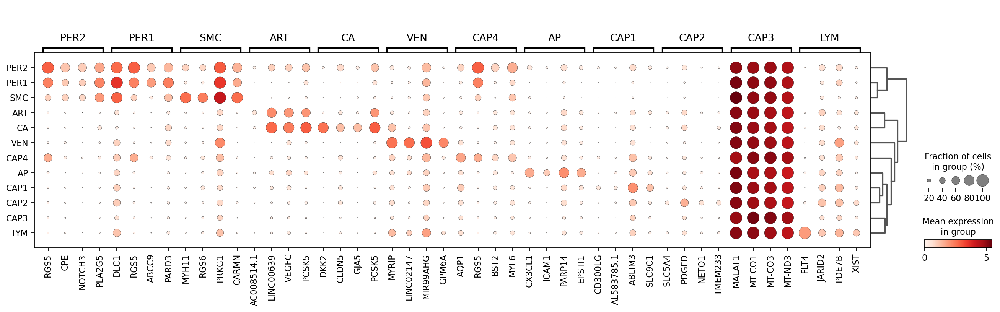

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


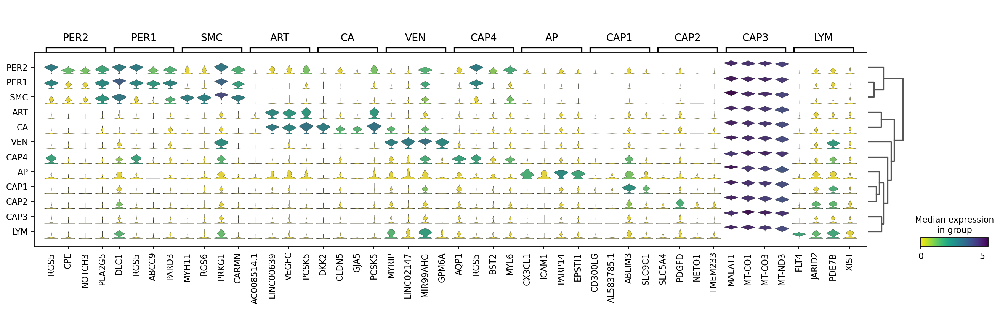

In [95]:
sc.tl.rank_genes_groups(subadata, 'subtypes', method='logreg', n_genes = 1000)
sc.pl.rank_genes_groups_dotplot(subadata, n_genes=4)
#sc.pl.rank_genes_groups_dotplot(subadata, n_genes=4, values_to_plot='logfoldchanges', min_logfoldchange=3, vmax=7, vmin=-7, cmap='bwr')
sc.pl.rank_genes_groups_stacked_violin(subadata, n_genes=4, cmap='viridis_r')

ranking genes


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:17)


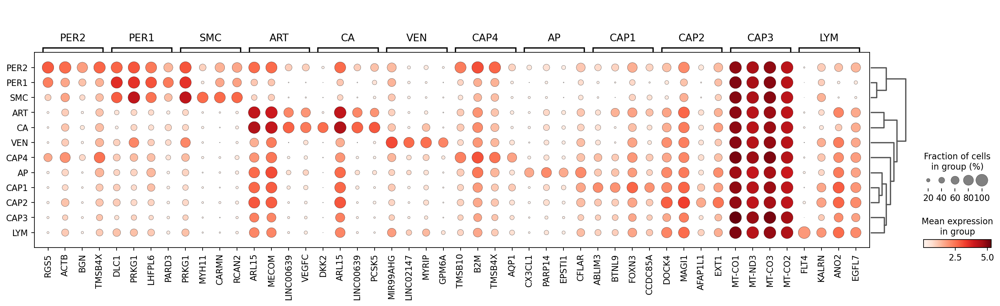

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


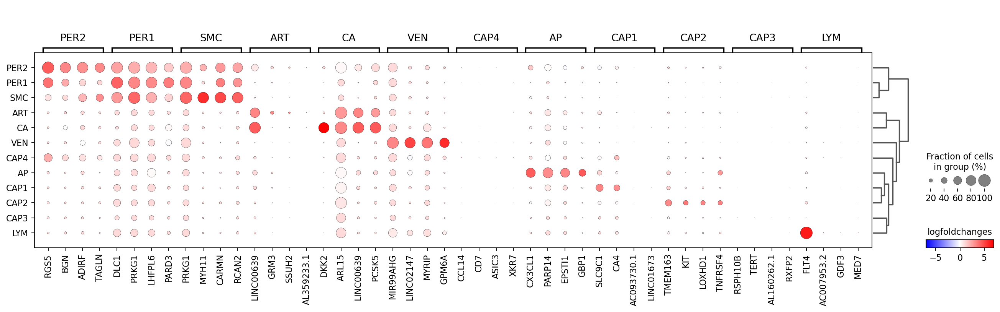

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


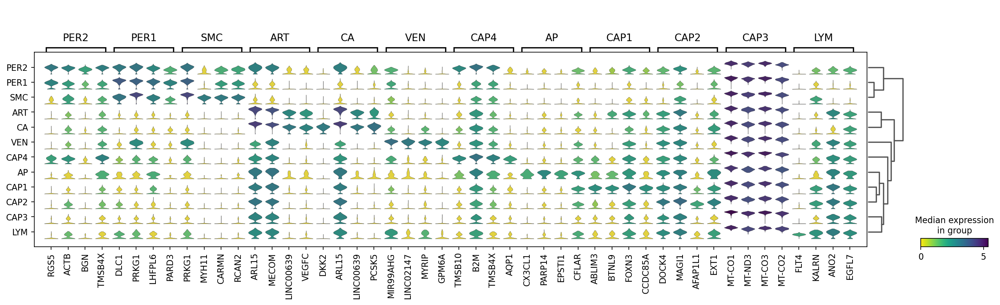

In [96]:
sc.tl.rank_genes_groups(subadata, 'subtypes', method='wilcoxon', n_genes=subadata.shape[1])
sc.pl.rank_genes_groups_dotplot(subadata, n_genes=4)
sc.pl.rank_genes_groups_dotplot(subadata, n_genes=4, values_to_plot='logfoldchanges', min_logfoldchange=3, vmax=7, vmin=-7, cmap='bwr')
sc.pl.rank_genes_groups_stacked_violin(subadata, n_genes=4, cmap='viridis_r')

In [ ]:
sc.tl.rank_genes_groups(subadata, 'subtypes', method='logreg', n_genes = 1000)
for cell_type in set(subadata.obs.subtypes):
    print(cell_type)
    fig = sc.pl.rank_genes_groups_dotplot(subadata, groupby = 'subtypes', n_genes=30, groups = [cell_type], standard_scale = 'var', return_fig = True)
    fig.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, sort = 'descending', color = 'grey').swap_axes(True).show()

ranking genes


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:58)
ART


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: ART


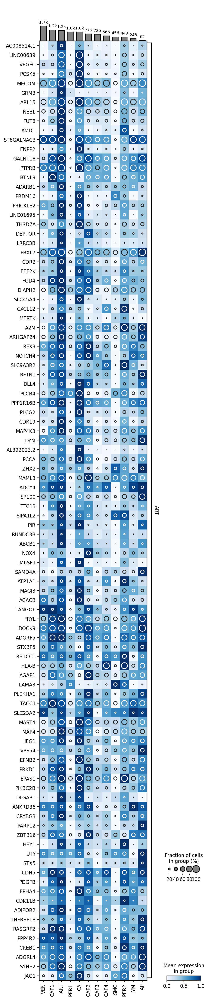

CAP2


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: CAP2


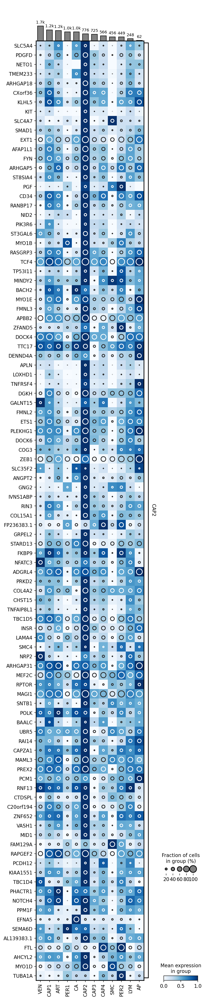

CAP3


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: CAP3


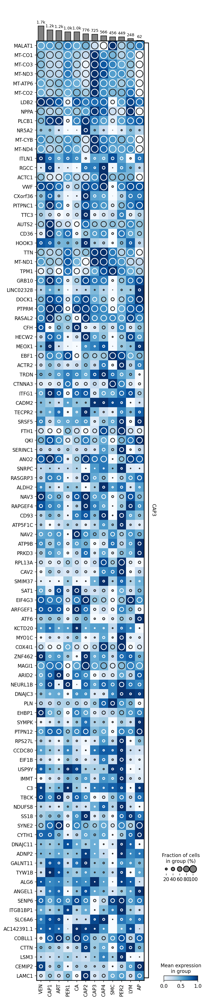

VEN


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: VEN


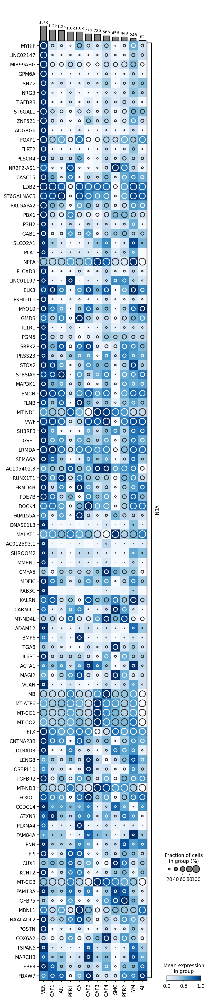

CAP1


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: CAP1


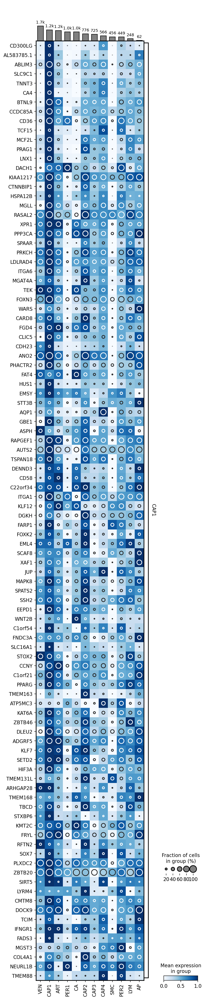

CA


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: CA


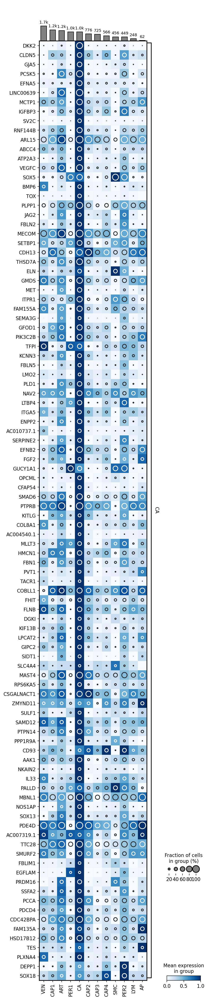

SMC


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: SMC


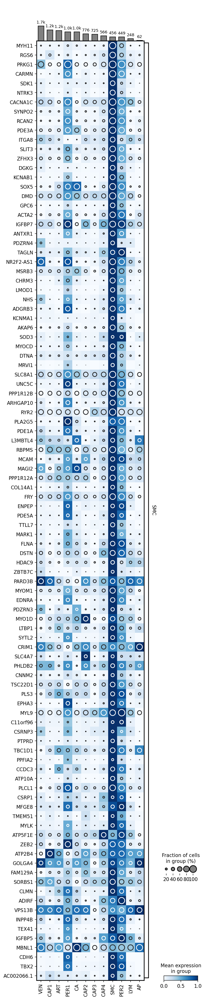

LYM


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: LYM


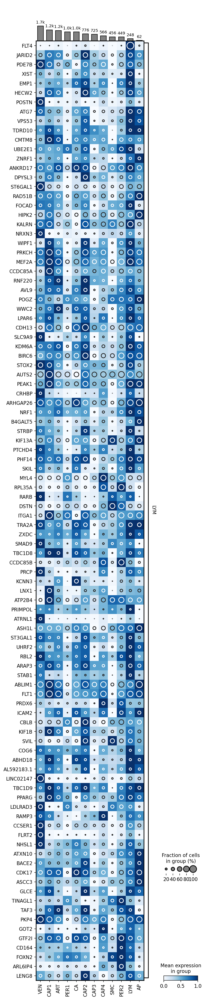

PER1


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: PER1


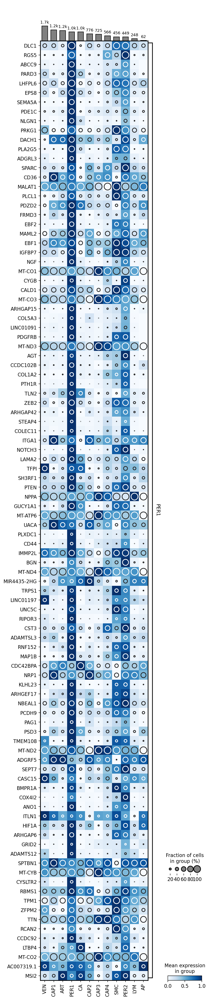

PER2


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: PER2


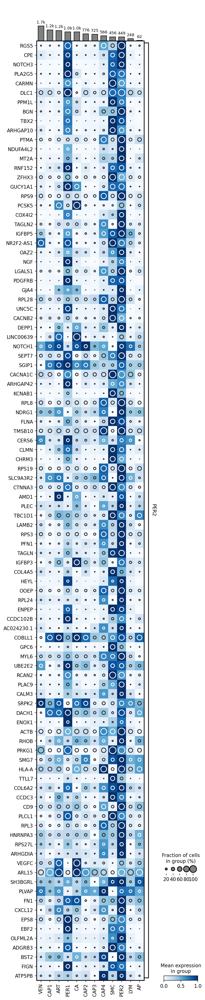

CAP4


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: CAP4


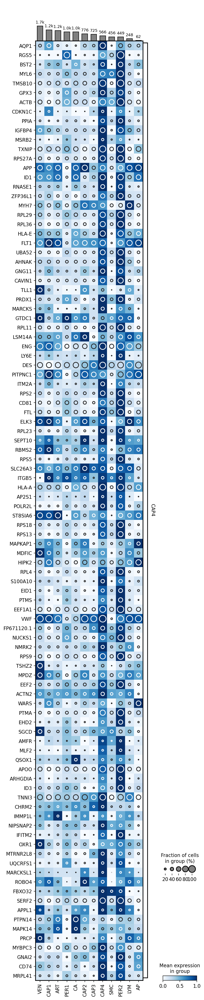

AP


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: AP


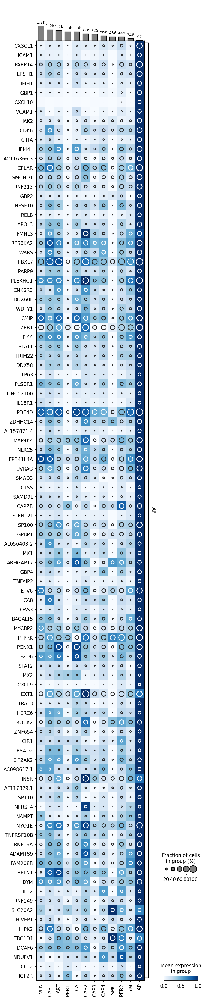

In [131]:
sc.tl.rank_genes_groups(subadata, 'subtypes', method='logreg', n_genes = 1000)
for cell_type in set(subadata.obs.subtypes):
    print(cell_type)
    fig = sc.pl.rank_genes_groups_dotplot(subadata, groupby = 'subtypes', n_genes=100, groups = [cell_type], standard_scale = 'var', return_fig = True)
    fig.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, sort = 'descending', color = 'grey').swap_axes(True).show()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['subtypes']"]`
categories: AP, ART, CA, etc.
var_group_labels: SMC, PER, Arterial PER, etc.


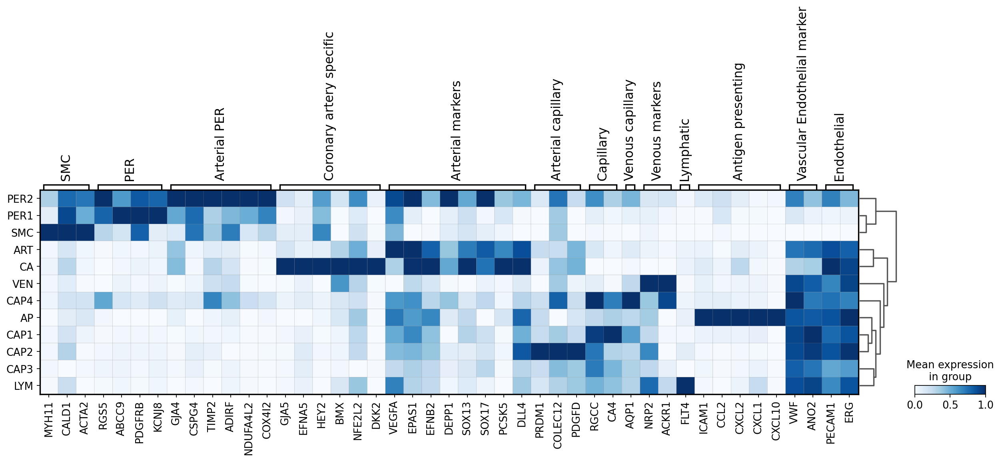

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: SMC, PER, Arterial PER, etc.


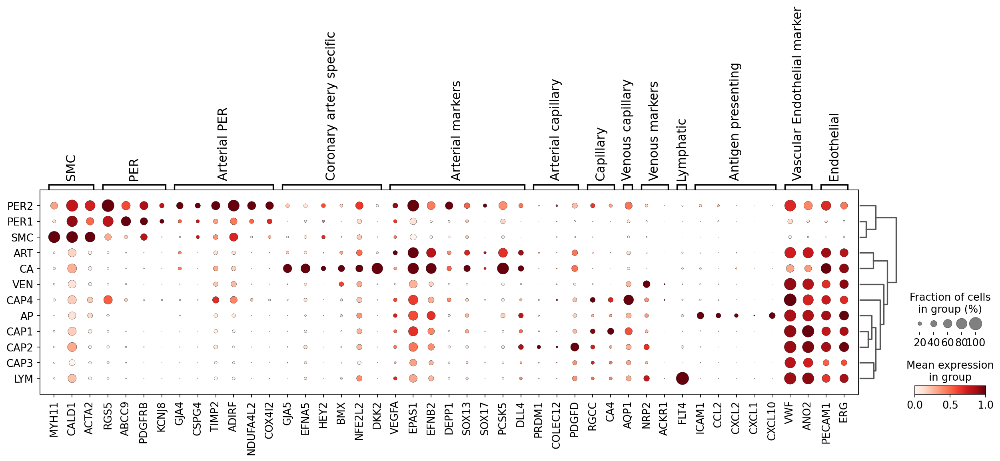

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: AP, ART, CA, etc.
var_group_labels: SMC, PER, Arterial PER, etc.


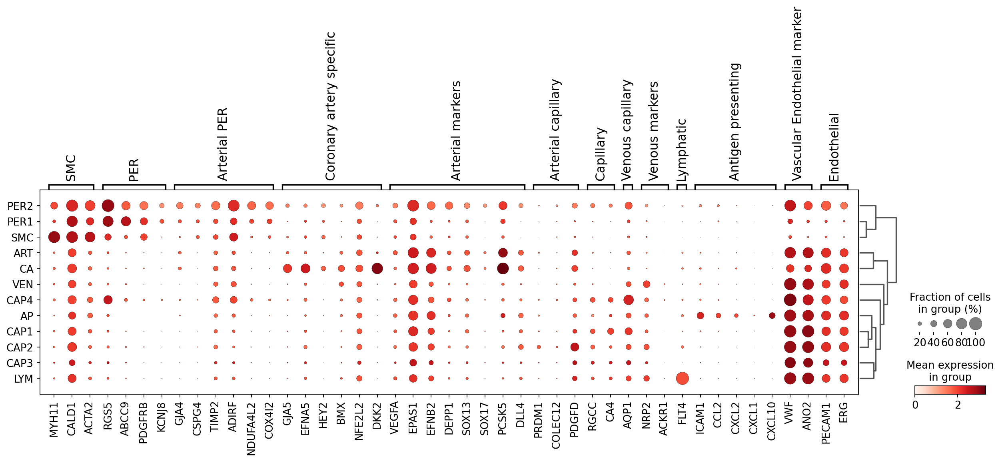

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


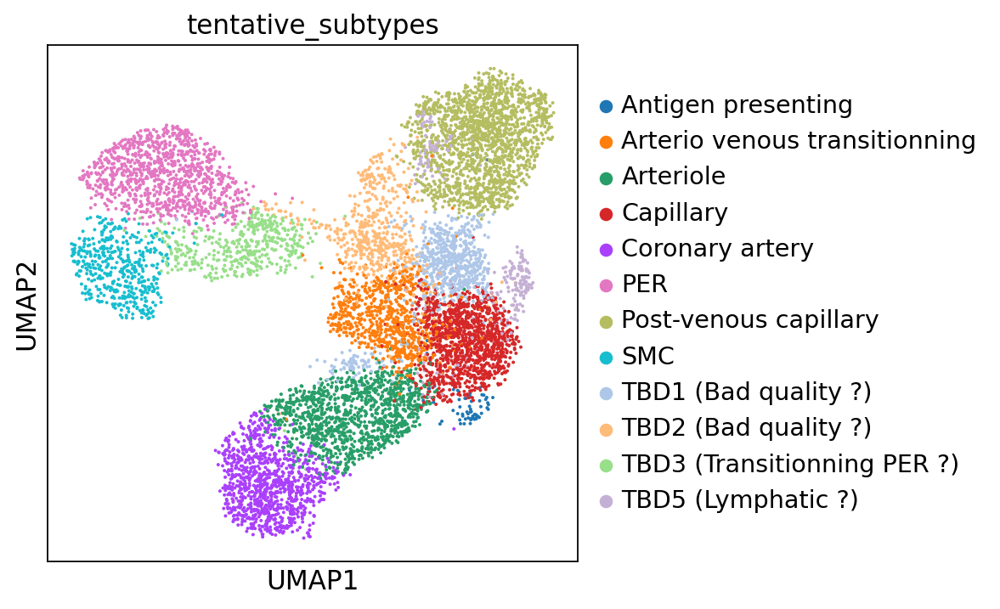

In [30]:
marker_genes_dict = {'PER': ['RGS5', 'ABCC9', 'PDGFRB', 'KCNJ8'],
                     'SMC': ['MYH11', 'CALD1', 'ACTA2'],
                     'Arterial markers': ['VEGFA', 'EPAS1', 'EFNB2', 'DEPP1', 'SOX13', 'SOX17'],
                     'Coronary artery specific': ['GJA5', 'EFNA5', 'HEY2', 'BMX'],
                     'Post-venous Capillary': ['NRP2', 'ACKR1'],
                     'Lymphatic': ['FLT4'],
                     'Antigen presenting': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'Arteriovenous Transitionning': ['PRDM1', 'ST3GAL6', 'NOTCH1', 'NOTCH4'],
                     'Capillary': ['RGCC', 'CA4'],
                     'Vascular Endothelial marker': ['VWF', 'ANO2'],
                     'Endothelial': ['PECAM1', 'ERG']
                    }
marker_genes_dict = {'Post-venous Capillary': ['NRP2', 'ACKR1'],
                     'Capillary': ['RGCC', 'CA4'],
                     'Arterial markers': ['VEGFA', 'EPAS1', 'EFNB2', 'DEPP1', 'SOX13', 'SOX17'],
                     'PER': ['RGS5', 'ABCC9', 'PDGFRB', 'KCNJ8'],
                     'Coronary artery specific': ['GJA5', 'EFNA5', 'HEY2', 'BMX'],
                     'Arteriovenous Transitionning': ['PRDM1', 'ST3GAL6', 'NOTCH1', 'NOTCH4'],
                     'SMC': ['MYH11', 'CALD1', 'ACTA2'],
                     'Capillary': ['RGCC', 'CA4'],
                     'Lymphatic': ['FLT4'],
                     'Antigen presenting': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'Vascular Endothelial marker': ['VWF', 'ANO2'],
                     'Endothelial': ['PECAM1', 'ERG']
                    }
marker_genes_dict = {'SMC': ['MYH11', 'CALD1', 'ACTA2'],
                     'PER': ['RGS5', 'ABCC9', 'PDGFRB', 'KCNJ8'],
                     'Arterial PER': ['GJA4', 'CSPG4', 'TIMP2', 'ADIRF', 'NDUFA4L2', 'COX4I2'],
                     'Coronary artery specific': ['GJA5', 'EFNA5', 'HEY2', 'BMX', "NFE2L2", "DKK2"],
                     'Arterial markers': ['VEGFA', 'EPAS1', 'EFNB2', 'DEPP1', 'SOX13', 'SOX17', 'PCSK5', 'DLL4'],
                     'Arterial capillary': ['PRDM1', 'COLEC12', 'PDGFD'],
                     'Capillary': ['RGCC', 'CA4'],
                     'Venous capillary': ['AQP1'],
                     'Venous markers': ['NRP2', 'ACKR1'],
                     'Lymphatic': ['FLT4'],
                     'Antigen presenting': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'Vascular Endothelial marker': ['VWF', 'ANO2'],
                     'Endothelial': ['PECAM1', 'ERG']
                    }
sc.tl.dendrogram(subadata, groupby='subtypes')
sc.pl.matrixplot(subadata, marker_genes_dict, groupby = "subtypes", use_raw = True, 
                 standard_scale = "var",
                 cmap = "Blues", save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, marker_genes_dict, groupby = "subtypes", use_raw = True, 
                 standard_scale = "var",
                 save="heatmap.png", dendrogram = True)
sc.pl.dotplot(subadata, marker_genes_dict, groupby = "subtypes", use_raw = True, 
                 save="heatmap.png", dendrogram = True, mean_only_expressed = True)
sc.pl.umap(subadata, color = 'tentative_subtypes')

Part A of fig <a name='fig_A' />

In [21]:
marker_genes_dict = {'SMC': ['MYH11', 'ACTA2'],
                     'PER': ['RGS5', 'ABCC9', 'KCNJ8'],
                     'Arterial PER': ['GJA4', 'ADIRF', 'NDUFA4L2', 'COX4I2'],
                     'Coronary artery': ['GJA5', 'EFNA5', 'BMX', "DKK2", 'VEGFC'],
                     'Arterial': ['EPAS1', 'EFNB2', 'SOX13', 'PCSK5', 'DLL4', 'SOX17', 'DEPP1',  'VEGFA'],
                     'Arterial capillary': ['PRDM1', 'COLEC12', 'PDGFD'],
                     'Capillary': ['RGCC', 'CA4'],
                     'Venous capillary': ['AQP1'],
                     'Venous markers': ['NRP2', 'ACKR1'],
                     'Lymphatic': ['FLT4'],
                     'Antigen presenting': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'Vascular Endothelial': ['VWF', 'ANO2'],
                     'Endothelial': ['PECAM1', 'ERG']
                    }

In [22]:
marker_genes_dict = {'SMC': ['MYH11', 'ACTA2'],
                     'PER': ['RGS5', 'ABCC9', 'KCNJ8'],
                     'PER2': ['GJA4', 'ADIRF', 'NDUFA4L2', 'COX4I2'],
                     'Coronary': ['GJA5', 'EFNA5', 'BMX', "DKK2", 'VEGFC'],
                     'Arterial': ['EPAS1', 'EFNB2', 'SOX13', 'PCSK5', 'DLL4', 'SOX17', 'DEPP1',  'VEGFA'],
                     'Capillary': ['PRDM1', 'COLEC12', 'PDGFD', 'RGCC', 'CA4', 'AQP1'],
                     'VEN': ['NRP2', 'ACKR1'],
                     'LYM': ['FLT4'],
                     'AP': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'VEC': ['VWF', 'ANO2'],
                     'EC': ['PECAM1', 'ERG']
                    }

In [23]:
marker_genes_dict = {'Smooth muscle': ['MYH11', 'ACTA2'],
                     'Pericyte': ['RGS5', 'ABCC9', 'KCNJ8'],
                     'Pericyte 2': ['GJA4', 'ADIRF', 'NDUFA4L2', 'COX4I2'],
                     'Coronary artery': ['GJA5', 'EFNA5', 'BMX', "DKK2", 'VEGFC'],
                     'Arterial': ['EPAS1', 'EFNB2', 'SOX13', 'PCSK5', 'DLL4', 'SOX17', 'DEPP1',  'VEGFA'],
                     'Capillary': ['PRDM1', 'COLEC12', 'PDGFD', 'RGCC', 'CA4', 'AQP1'],
                     'Venous': ['NRP2', 'ACKR1'],
                     'Lymphatic': ['FLT4'],
                     'Antigen Presenting': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'Vascular EC': ['VWF', 'ANO2'],
                     'Endothelial cell (EC)': ['PECAM1', 'ERG']
                    }

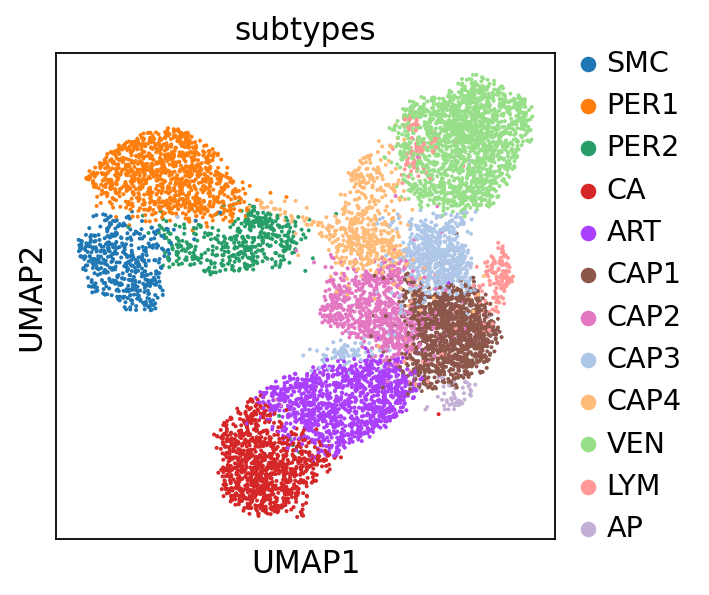

In [24]:
sc.pl.umap(subadata, color = ["subtypes"])

In [34]:
subadata.obs.subtypes = subadata.obs.subtypes.cat.reorder_categories(['SMC', 'PER1', 'PER2', 'CA', 'ART', 'CAP1', 'CAP2', 'CAP3', 'CAP4', 'VEN', 'LYM', 'AP'])

In [24]:
subadata.obs['subtypes_full2'] = subadata.obs['subtypes'].replace({ "SMC" : "Smooth muscle", "PER1" : "Pericyte 1", "PER2" : "Pericyte 2", "CA" : "Coronary artery",
                                                                  "ART" : "Arteriole", "CAP1": "Capillary 1", "CAP2" : "Capillary 2", "CAP3" : "Capillary 3", 
                                                                   "CAP4": "Capillary 4", "VEN" : "Venous", "LYM": "Lymphatic", "IF" : "Inflammatory"})

... storing 'subtypes_full2' as categorical


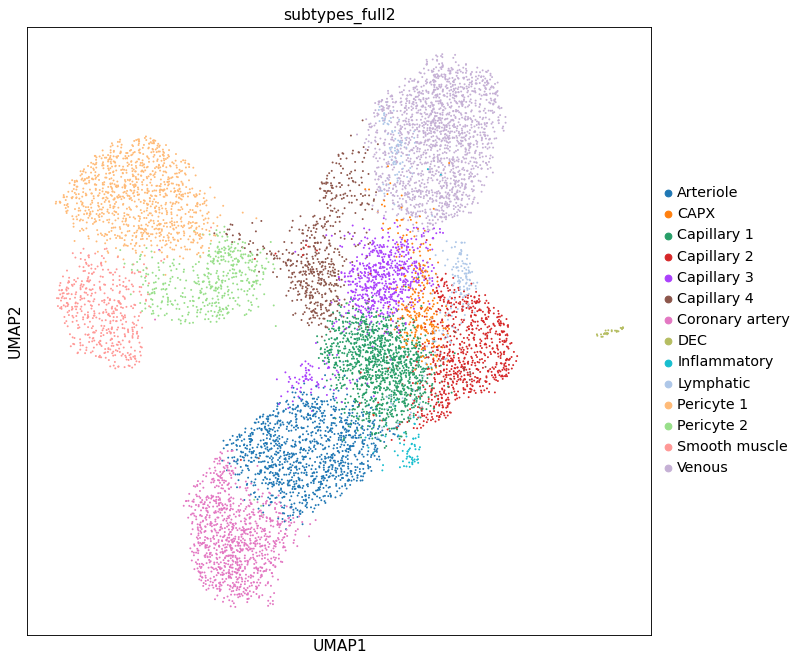

In [25]:
sc.pl.umap(subadata, color = ["subtypes_full2"])

In [37]:
subadata.obs.subtypes_full2 = subadata.obs.subtypes_full2.cat.reorder_categories(['Smooth muscle', 'Pericyte 1', 'Pericyte 2', 'Coronary artery', 'Arteriole', 
                                                                                  'Capillary 1', 'Capillary 2', 'Capillary 3', 'Capillary 4', 'Venous', 'Lymphatic', 
                                                                                  'Antigen presenting'])

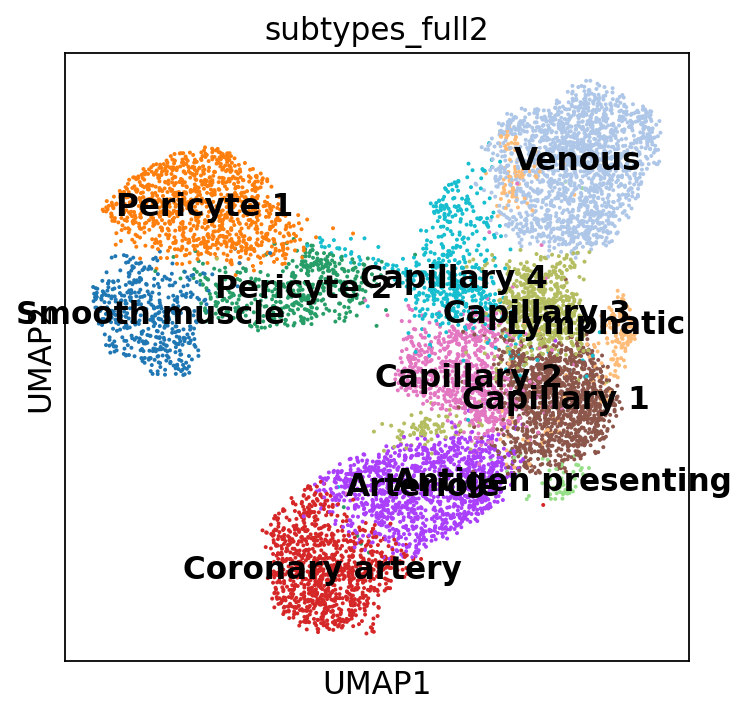

In [46]:
sc.pl.umap(subadata, color = ['subtypes_full2'], legend_loc = 'on data')

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


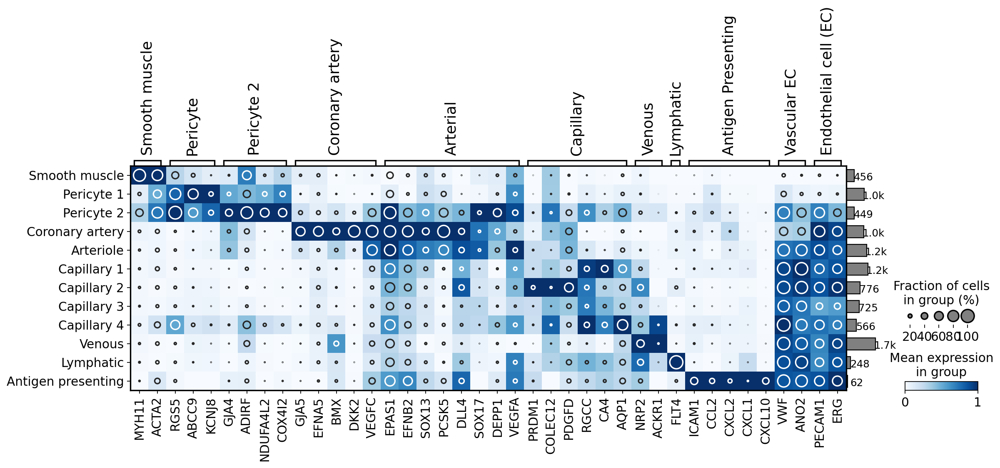

In [41]:
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16})
rcParams['figure.figsize'] = 5,5
dp = sc.pl.dotplot(subadata, marker_genes_dict, groupby = "subtypes_full2", use_raw = True, 
                 standard_scale = 'var', return_fig = True, var_group_rotation = 90)
dp.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, color = 'grey').swap_axes(False).savefig('../figures/fig1/heat.svg')

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


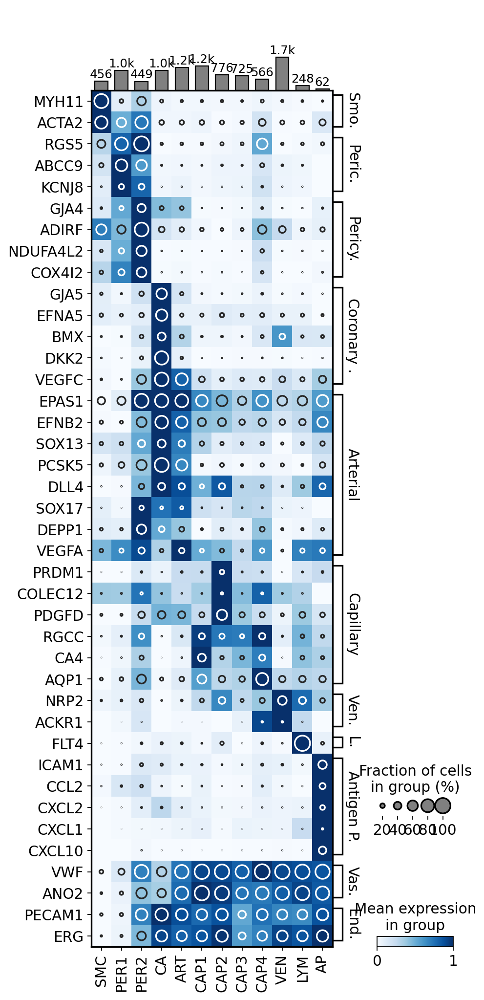

In [48]:
dp = sc.pl.dotplot(subadata, marker_genes_dict, groupby = "subtypes", use_raw = True, 
                 standard_scale = 'var', return_fig=True, mean_only_expressed = False)
dp.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, color = 'grey').swap_axes(True).show()

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['tentative_subtypes']"]`
categories: Antigen presenting, Arterio venous transitionning, Arteriole, etc.
var_group_labels: Smooth muscle, Pericyte, Pericyte 2, etc.


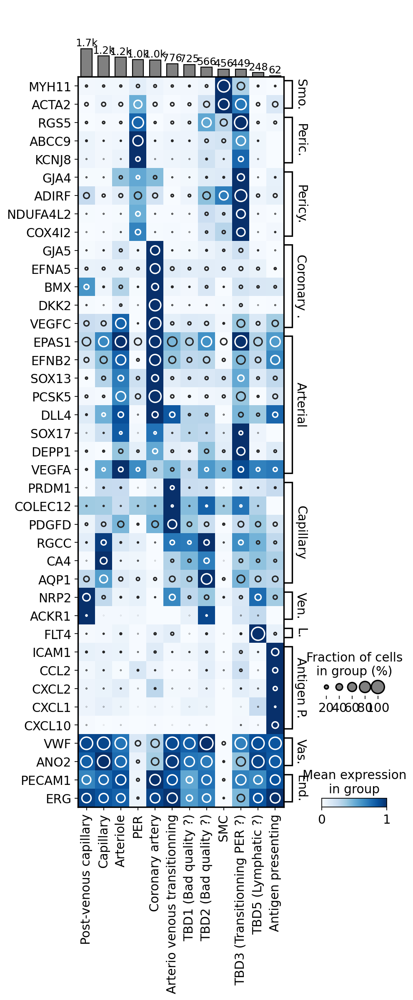

In [49]:
dp = sc.pl.dotplot(subadata, marker_genes_dict, groupby = "tentative_subtypes", use_raw = True,
                 dendrogram = True, standard_scale = 'var', return_fig=True, mean_only_expressed = False)
dp.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, sort = 'descending', color = 'grey').swap_axes(True).savefig('../figures/fig2/heatt2.svg')

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


categories: SMC, PER1, PER2, etc.
var_group_labels: Smooth muscle, Pericyte, Pericyte 2, etc.


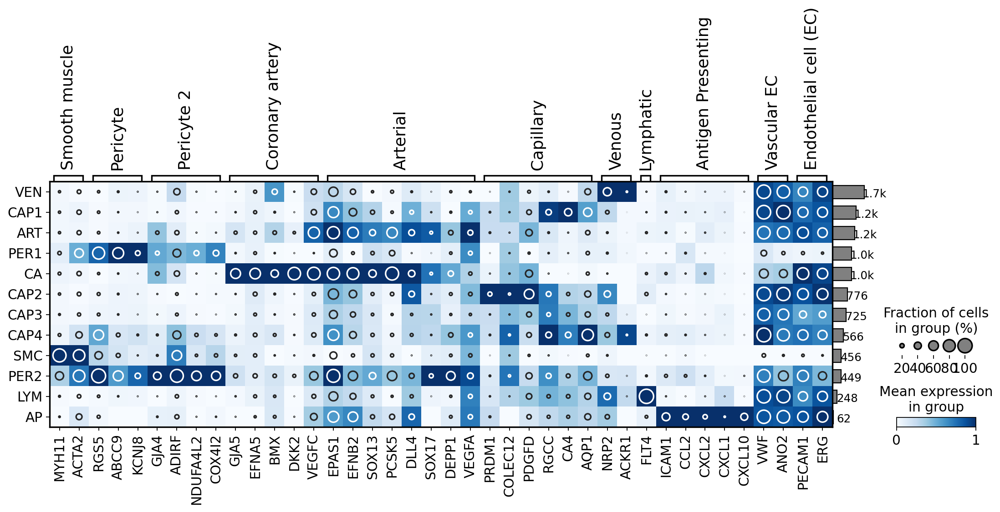

In [50]:
dp = sc.pl.dotplot(subadata, marker_genes_dict, groupby = "subtypes", use_raw = True, 
                 dendrogram = True, standard_scale = 'var', return_fig=True)
dp.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, sort = 'descending', color = 'grey').swap_axes(False).savefig('../figures/fig2/heat_names.svg')

In [52]:
marker_genes_dict = {'SMC': ['MYH11', 'ACTA2'],
                     'PER': ['RGS5', 'ABCC9'],
                     'PER2': ['GJA4', 'ADIRF', 'NDUFA4L2'],
  'Coronary': ['GJA5', 'EFNA5', 'BMX', "DKK2", 'VEGFC'],
                     'Arterial': ['EPAS1', 'EFNB2', 'SOX13', 'PCSK5'],
                     'Capillary': ['PRDM1', 'PDGFD', 'RGCC', 'CA4'],
                     'Ven.': ['NRP2', 'ACKR1'],
                     'L.': ['FLT4'],
                     'AP': ['ICAM1', 'CCL2'],
                     'VEC': ['VWF', 'ANO2'],
                     'EC': ['PECAM1', 'ERG']
                    }

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


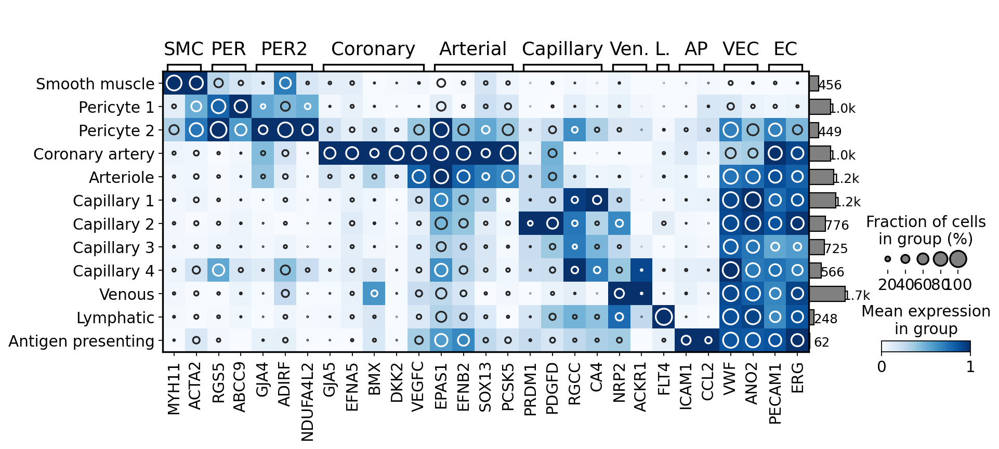

In [53]:
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16})
rcParams['figure.figsize'] = 5,5
dp = sc.pl.dotplot(subadata, marker_genes_dict, groupby = "subtypes_full2", use_raw = True, 
                 standard_scale = 'var', return_fig = True, var_group_rotation = 0)
dp.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, color = 'grey').swap_axes(False).savefig('../figures/fig1/heat.svg')

In [26]:
genes_mouse = {
    "Artery": ["FBLN1", "HEY1", "SOX17", "ALPL", "RGS5", "GJA4", "GJA5", "DLL4", "BTG2", "CYR61"],
    "Vein": ["NPR3", "VWF", "IGFBP4", "SMOC1", "DCN", "MGP", "CYTL1", "TM4SF1", "FABP5", "ID2"],
    "Capillary Arterial": ["PDGFD", "CXCL12", "RBP7", "SEMA7A", "CLEC2D", "UNC5B", "MCF2L", "CXCR4", "MERTK", "PLEKHG2"],
    "Capillary Venous": ["IER3", "PLTP", "FMO2", "CALCRL", "BSG", "SOCS3", "EMP2", "ATF3", "LMO1", "CSF1"],
    "Capillary": ["KDR", "SSH2", "LNX2", "MAP3K14", "ANGPTL4", "AKAP5", "SCLY", "ACVR2A", "CECR2"]
}

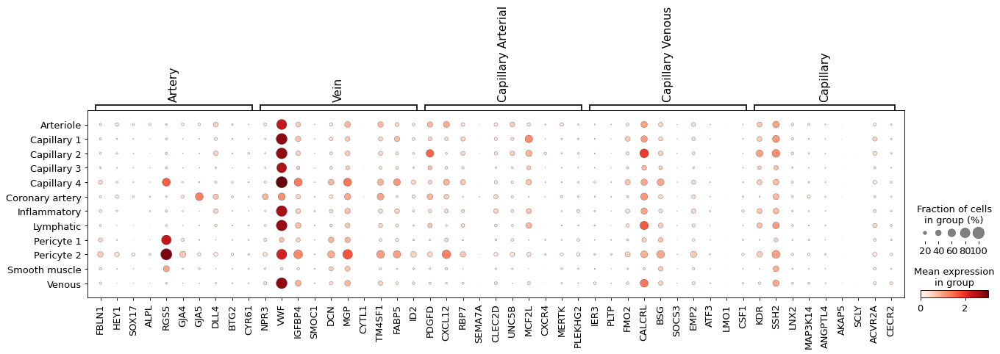

/home/schmauch/data-lab5/conda/envs/scCAD/lib/python3.9/site-packages/pandas/plotting/_matplotlib/tools.py:395: MatplotlibDeprecationWarning: 
The is_last_row function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_last_row() instead.
  if ax.is_last_row():


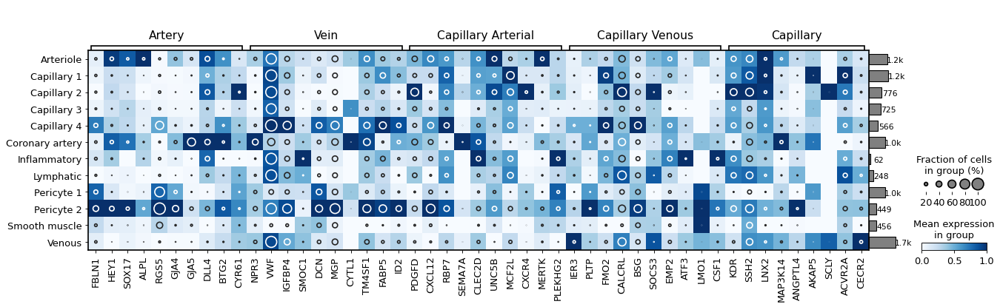

In [34]:
sc.pl.dotplot(subadata, genes_mouse, groupby = "subtypes_full2", use_raw = True)
dp = sc.pl.dotplot(subadata, genes_mouse, groupby = "subtypes_full2", use_raw = True, 
                 dendrogram = False, standard_scale = 'var', return_fig=True, var_group_rotation = 0)
dp.style(color_on='square', largest_dot = 200, dot_edge_lw = 1.5, cmap = 'Blues', dot_edge_color = None).add_totals(True, color = 'grey').swap_axes(False).savefig('../figures/fig2/heat_names.svg')

Code for scatter <a name='scatter_code' />

In [15]:
import collections.abc as cabc
from typing import Union, Optional, Sequence, Any, Mapping, List, Tuple, Callable

import numpy as np
from anndata import AnnData
from cycler import Cycler
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from pandas.api.types import is_categorical_dtype
from matplotlib import pyplot as pl, colors
from matplotlib import rcParams
from matplotlib import patheffects
from matplotlib.colors import Colormap
from functools import partial

from scanpy.plotting import _utils
from scanpy.plotting._utils import (
    _IGraphLayout,
    _FontWeight,
    _FontSize,
    circles,
    make_projection_available,
)

from scanpy import logging as logg
from scanpy._settings import settings
from scanpy._utils import sanitize_anndata, _doc_params, Empty, _empty
from scanpy._compat import Literal

VMinMax = Union[str, float, Callable[[Sequence[float]], float]]

def embedding(
    adata: AnnData,
    basis: str,
    *,
    color: Union[str, Sequence[str], None] = None,
    gene_symbols: Optional[str] = None,
    use_raw: Optional[bool] = None,
    sort_order: bool = True,
    edges: bool = False,
    edges_width: float = 0.1,
    edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey',
    neighbors_key: Optional[str] = None,
    arrows: bool = False,
    arrows_kwds: Optional[Mapping[str, Any]] = None,
    groups: Optional[str] = None,
    components: Union[str, Sequence[str]] = None,
    layer: Optional[str] = None,
    projection: Literal['2d', '3d'] = '2d',
    # image parameters
    img_key: Optional[str] = None,
    crop_coord: Tuple[int, int, int, int] = None,
    alpha_img: float = 1.0,
    bw: bool = False,
    library_id: str = None,
    #
    color_map: Union[Colormap, str, None] = None,
    palette: Union[str, Sequence[str], Cycler, None] = None,
    size: Union[float, Sequence[float], None] = None,
    frameon: Optional[bool] = None,
    legend_fontsize: Union[int, float, _FontSize, None] = None,
    legend_fontweight: Union[int, _FontWeight] = 'bold',
    legend_loc: str = 'right margin',
    legend_fontoutline: Optional[int] = None,
    vmax: Union[VMinMax, Sequence[VMinMax], None] = None,
    vmin: Union[VMinMax, Sequence[VMinMax], None] = None,
    add_outline: Optional[bool] = False,
    outline_width: Tuple[float, float] = (0.3, 0.05),
    outline_color: Tuple[str, str] = ('black', 'white'),
    ncols: int = 4,
    hspace: float = 0.25,
    wspace: Optional[float] = None,
    title: Union[str, Sequence[str], None] = None,
    show: Optional[bool] = None,
    save: Union[bool, str, None] = None,
    ax: Optional[Axes] = None,
    return_fig: Optional[bool] = None,
    show_legend = True,
    **kwargs,
) -> Union[Figure, Axes, None]:
    """\
    Scatter plot for user specified embedding basis (e.g. umap, pca, etc)
    Parameters
    ----------
    basis
        Name of the `obsm` basis to use.
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """

    sanitize_anndata(adata)
    if color_map is not None:
        kwargs['cmap'] = color_map
    if size is not None:
        kwargs['s'] = size
    if 'edgecolor' not in kwargs:
        # by default turn off edge color. Otherwise, for
        # very small sizes the edge will not reduce its size
        # (https://github.com/theislab/scanpy/issues/293)
        kwargs['edgecolor'] = 'none'

    if groups:
        if isinstance(groups, str):
            groups = [groups]

    make_projection_available(projection)
    args_3d = dict(projection='3d') if projection == '3d' else {}

    # Deal with Raw
    if use_raw is None:
        # check if adata.raw is set
        use_raw = layer is None and adata.raw is not None
    if use_raw and layer is not None:
        raise ValueError(
            "Cannot use both a layer and the raw representation. Was passed:"
            f"use_raw={use_raw}, layer={layer}."
        )

    if wspace is None:
        #  try to set a wspace that is not too large or too small given the
        #  current figure size
        wspace = 0.75 / rcParams['figure.figsize'][0] + 0.02
    if adata.raw is None and use_raw:
        raise ValueError(
            "`use_raw` is set to True but AnnData object does not have raw. "
            "Please check."
        )
    # turn color into a python list
    color = [color] if isinstance(color, str) or color is None else list(color)
    if title is not None:
        # turn title into a python list if not None
        title = [title] if isinstance(title, str) else list(title)

    # get the points position and the components list
    # (only if components is not None)
    data_points, components_list = sc.pl._tools.scatterplots._get_data_points(
        adata, basis, projection, components, img_key, library_id
    )

    # Setup layout.
    # Most of the code is for the case when multiple plots are required
    # 'color' is a list of names that want to be plotted.
    # Eg. ['Gene1', 'louvain', 'Gene2'].
    # component_list is a list of components [[0,1], [1,2]]
    if (
        not isinstance(color, str)
        and isinstance(color, cabc.Sequence)
        and len(color) > 1
    ) or len(components_list) > 1:
        if ax is not None:
            raise ValueError(
                "Cannot specify `ax` when plotting multiple panels "
                "(each for a given value of 'color')."
            )
        if len(components_list) == 0:
            components_list = [None]

        # each plot needs to be its own panel
        num_panels = len(color) * len(components_list)
        fig, grid = sc.pl._tools.scatterplots._panel_grid(hspace, wspace, ncols, num_panels)
    else:
        if len(components_list) == 0:
            components_list = [None]
        grid = None
        if ax is None:
            fig = pl.figure()
            ax = fig.add_subplot(111, **args_3d)

    # turn vmax and vmin into a sequence
    if isinstance(vmax, str) or not isinstance(vmax, cabc.Sequence):
        vmax = [vmax]
    if isinstance(vmin, str) or not isinstance(vmin, cabc.Sequence):
        vmin = [vmin]

    if 's' in kwargs:
        size = kwargs.pop('s')

    if size is not None:
        # check if size is any type of sequence, and if so
        # set as ndarray
        import pandas.core.series

        if (
            size is not None
            and isinstance(
                size, (cabc.Sequence, pandas.core.series.Series, np.ndarray,)
            )
            and len(size) == adata.shape[0]
        ):
            size = np.array(size, dtype=float)
    else:
        size = 120000 / adata.shape[0]

    ###
    # make the plots
    axs = []
    import itertools

    idx_components = range(len(components_list))

    # use itertools.product to make a plot for each color and for each component
    # For example if color=[gene1, gene2] and components=['1,2, '2,3'].
    # The plots are: [
    #     color=gene1, components=[1,2], color=gene1, components=[2,3],
    #     color=gene2, components = [1, 2], color=gene2, components=[2,3],
    # ]
    for count, (value_to_plot, component_idx) in enumerate(
        itertools.product(color, idx_components)
    ):
        color_vector, categorical = sc.pl._tools.scatterplots._get_color_values(
            adata,
            value_to_plot,
            layer=layer,
            groups=groups,
            palette=palette,
            use_raw=use_raw,
            gene_symbols=gene_symbols,
        )

        # check if higher value points should be plot on top
        if sort_order is True and value_to_plot is not None and categorical is False:
            order = np.argsort(color_vector)
            color_vector = color_vector[order]
            _data_points = data_points[component_idx][order, :]

            # check if 'size' is given (stored in kwargs['s']
            # and reorder it.
            if isinstance(size, np.ndarray):
                size = np.array(size)[order]
        else:
            _data_points = data_points[component_idx]

        # if plotting multiple panels, get the ax from the grid spec
        # else use the ax value (either user given or created previously)
        if grid:
            ax = pl.subplot(grid[count], **args_3d)
            axs.append(ax)
        if not (settings._frameon if frameon is None else frameon):
            ax.axis('off')
        if title is None:
            if value_to_plot is not None:
                ax.set_title(value_to_plot)
            else:
                ax.set_title('')
        else:
            try:
                ax.set_title(title[count])
            except IndexError:
                logg.warning(
                    "The title list is shorter than the number of panels. "
                    "Using 'color' value instead for some plots."
                )
                ax.set_title(value_to_plot)

        # check vmin and vmax options
        if categorical:
            kwargs['vmin'] = kwargs['vmax'] = None
        else:
            kwargs['vmin'], kwargs['vmax'] = sc.pl._tools.scatterplots._get_vmin_vmax(
                vmin, vmax, count, color_vector
            )

        # make the scatter plot
        if projection == '3d':
            cax = ax.scatter(
                _data_points[:, 0],
                _data_points[:, 1],
                _data_points[:, 2],
                marker=".",
                c=color_vector,
                rasterized=settings._vector_friendly,
                **kwargs,
            )
        else:
            if img_key is not None:
                # had to return size_spot cause spot size is set according
                # to the image to be plotted
                img_processed, img_coord, size_spot, cmap_img = _process_image(
                    adata, data_points, img_key, crop_coord, size, library_id, bw
                )
                ax.imshow(img_processed, cmap=cmap_img, alpha=alpha_img)
                ax.set_xlim(img_coord[0], img_coord[1])
                ax.set_ylim(img_coord[3], img_coord[2])
            elif img_key is None and library_id is not None:
                # order of magnitude similar to public visium
                size_spot = 70 * size

            scatter = (
                partial(ax.scatter, s=size)
                if library_id is None
                else partial(circles, s=size_spot, ax=ax)
            )

            if add_outline:
                # the default outline is a black edge followed by a
                # thin white edged added around connected clusters.
                # To add an outline
                # three overlapping scatter plots are drawn:
                # First black dots with slightly larger size,
                # then, white dots a bit smaller, but still larger
                # than the final dots. Then the final dots are drawn
                # with some transparency.

                bg_width, gap_width = outline_width
                point = np.sqrt(size)
                gap_size = (point + (point * gap_width) * 2) ** 2
                bg_size = (np.sqrt(gap_size) + (point * bg_width) * 2) ** 2
                # the default black and white colors can be changes using
                # the contour_config parameter
                bg_color, gap_color = outline_color

                # remove edge from kwargs if present
                # because edge needs to be set to None
                kwargs['edgecolor'] = 'none'

                # remove alpha for outline
                alpha = kwargs.pop('alpha') if 'alpha' in kwargs else None

                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=bg_size,
                    marker=".",
                    c=bg_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=gap_size,
                    marker=".",
                    c=gap_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                # if user did not set alpha, set alpha to 0.7
                kwargs['alpha'] = 0.7 if alpha is None else alpha

            if groups:
                # first plot non-groups and then plot the
                # required groups on top

                in_groups = np.array(adata.obs[value_to_plot].isin(groups))

                if isinstance(size, np.ndarray):
                    in_groups_size = size[in_groups]
                    not_in_groups_size = size[~in_groups]
                elif img_key is not None:
                    in_groups_size = not_in_groups_size = size_spot
                else:
                    in_groups_size = not_in_groups_size = size

                # only show grey points if no image is below
                if library_id is None:
                    ax.scatter(
                        _data_points[~in_groups, 0],
                        _data_points[~in_groups, 1],
                        s=not_in_groups_size,
                        marker=".",
                        c=color_vector[~in_groups],
                        rasterized=settings._vector_friendly,
                        **kwargs,
                    )
                cax = scatter(
                    _data_points[in_groups, 0],
                    _data_points[in_groups, 1],
                    s=in_groups_size,
                    marker=".",
                    c=color_vector[in_groups],
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

            else:
                cax = scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    marker=".",
                    c=color_vector,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

        # remove y and x ticks
        ax.set_yticks([])
        ax.set_xticks([])
        if projection == '3d':
            ax.set_zticks([])

        # set default axis_labels
        name = sc.pl._tools.scatterplots._basis2name(basis)
        if components is not None:
            axis_labels = [name + str(x + 1) for x in components_list[component_idx]]
        elif projection == '3d':
            axis_labels = [name + str(x + 1) for x in range(3)]

        else:
            axis_labels = [name + str(x + 1) for x in range(2)]

        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])
        if projection == '3d':
            # shift the label closer to the axis
            ax.set_zlabel(axis_labels[2], labelpad=-7)
        ax.autoscale_view()

        if edges:
            _utils.plot_edges(ax, adata, basis, edges_width, edges_color, neighbors_key)
        if arrows:
            _utils.plot_arrows(ax, adata, basis, arrows_kwds)

        if value_to_plot is None:
            # if only dots were plotted without an associated value
            # there is not need to plot a legend or a colorbar
            continue

        if legend_fontoutline is not None:
            path_effect = [
                patheffects.withStroke(linewidth=legend_fontoutline, foreground='w',)
            ]
        else:
            path_effect = None
        
        if show_legend:
            sc.pl._tools.scatterplots._add_legend_or_colorbar(
                adata,
                ax,
                cax,
                categorical,
                value_to_plot,
                legend_loc,
                _data_points,
                legend_fontweight,
                legend_fontsize,
                path_effect,
                groups,
                bool(grid),
            )

    if return_fig is True:
        return fig
    axs = axs if grid else ax
    _utils.savefig_or_show(basis, show=show, save=save)
    if show is False:
        return axs

    
def umap(adata, **kwargs) -> Union[Axes, List[Axes], None]:
    """\
    Scatter plot in UMAP basis.
    Parameters
    ----------
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """
    return embedding(adata, 'umap', **kwargs)

Other fig parts <a name='fig_B' />

In [108]:
genes = ['NRP2', 'RGCC', 'EFNB2', 'ABCC9', 'GJA5', 'PCSK5', 'MYH11', 'FLT4', 'ICAM1']
genes_celltypes = ['NRP2 (Venous)', 'RGCC (Capillary)', 'EFNB2 (Arterial)', 'ABCC9 (Pericyte)', 
                   'GJA5 (Coronary Artery)', 'PCSK5 (Arterial)', 'MYH11 (Smooth muscle)', 
                   'FLT4 (Lymphatics)', 'ICAM1 (Antigen Presenting)']

In [257]:
genes = ['NRP2', 'CA4', 'RGS5', 'GJA5', 'MYH11', 'FLT4']
genes_celltypes = ['NRP2 (Venous)', 'CA4 (Capillary)', 'RGS5 (Pericyte)', 
                   'GJA5 (Coronary Artery)', 'MYH11 (Smooth muscle)', 
                   'FLT4 (Lymphatics)']
genes = ['GJA5', 'CA4', 'MYH11', 'RGS5', 'FLT4', 'NRP2']
genes_celltypes = ['GJA5 (Coronary)', 'CA4 (Capillary)', 'MYH11 (SMC)', 
                   'RGS5 (Pericyte)', 'FLT4 (Lymphatics)', 
                   'NRP2 (Venous)']
genes = ['GJA5', 'EFNB2', 'RGCC', 'NRP2']
genes_celltypes = ['GJA5 (Coronary)', 'EFNB2 (Arterial)', 'RGCC (Capillary)', 'NRP2 (Venous)',]

In [110]:
subadata

AnnData object with n_obs × n_vars = 9343 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden', 'tentative_subtypes', 'subtypes_full', 'subtypes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt', 'cm'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'tentative_subtypes_colors', 'umap', 'subtypes_colors', 'subtypes_full_colors', 'dendrogram_subtypes', "dendrogram_['leiden']", "dendrogram_['subtypes']", "dendrogram_['tentative_subtypes']"
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

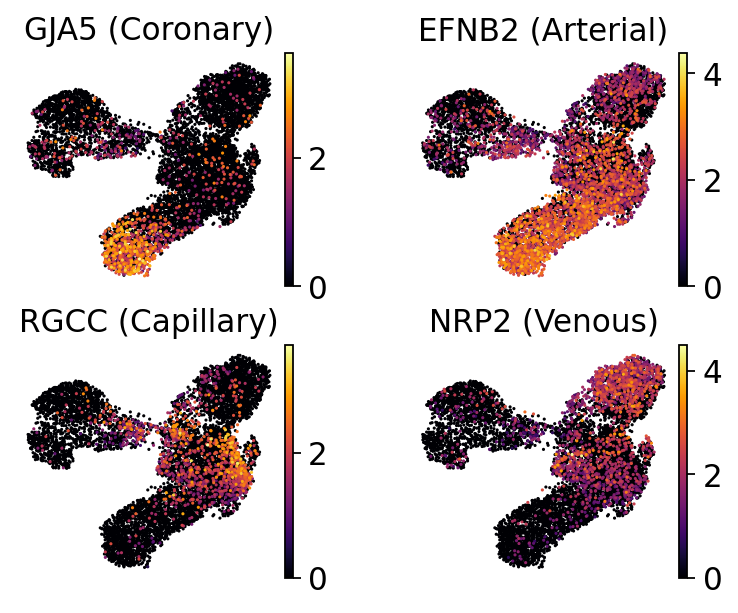

In [293]:
rcParams['figure.figsize'] = 2,2
rcParams['savefig.dpi'] = 300
sc.pl.umap(subadata, color = genes, title = genes_celltypes, size = 8, frameon = False, 
                 color_map = "inferno", ncols = 2, wspace = 0.35)

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


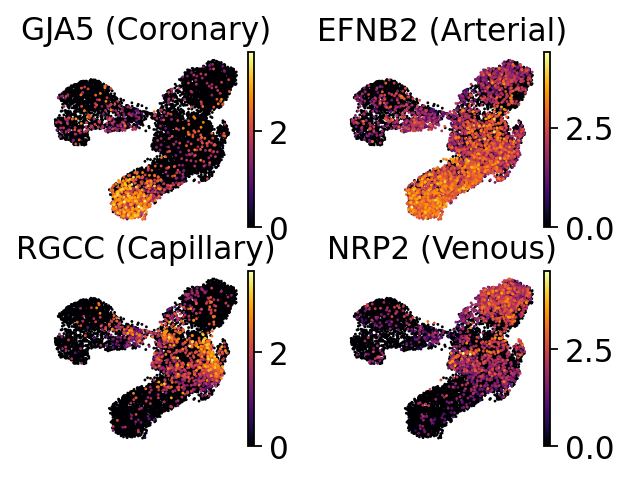

In [258]:
rcParams['figure.figsize'] = 1.5 ,1.5
rcParams['savefig.dpi'] = 300
sc.pl.umap(subadata, color = genes, title = genes_celltypes, size = 6.5, frameon = False, 
                 color_map = "inferno", save = "markers_exp.svg", ncols = 2, wspace = 0.35)

In [16]:
marker_genes_dict = {'Smooth muscle': ['MYH11', 'ACTA2'],
                     'Pericyte': ['RGS5', 'ABCC9', 'KCNJ8'],
                     'Pericyte 2': ['GJA4', 'ADIRF', 'NDUFA4L2', 'COX4I2'],
                     'Coronary artery': ['GJA5', 'EFNA5', 'BMX', "DKK2", 'VEGFC'],
                     'Arterial': ['EPAS1', 'EFNB2', 'SOX13', 'PCSK5', 'DLL4', 'SOX17', 'DEPP1',  'VEGFA'],
                     'Capillary': ['PRDM1', 'COLEC12', 'PDGFD', 'RGCC', 'CA4', 'AQP1'],
                     'Venous': ['NRP2', 'ACKR1'],
                     'Lymphatic': ['FLT4'],
                     'Antigen Presenting': ['ICAM1', 'CCL2', 'CXCL2', 'CXCL1', 'CXCL10'],
                     'Vascular EC': ['VWF', 'ANO2'],
                     'Endothelial cell (EC)': ['PECAM1', 'ERG']
                    }

In [23]:
genes_plots_all = [ item for elem in list(marker_genes_dict.values()) for item in elem]

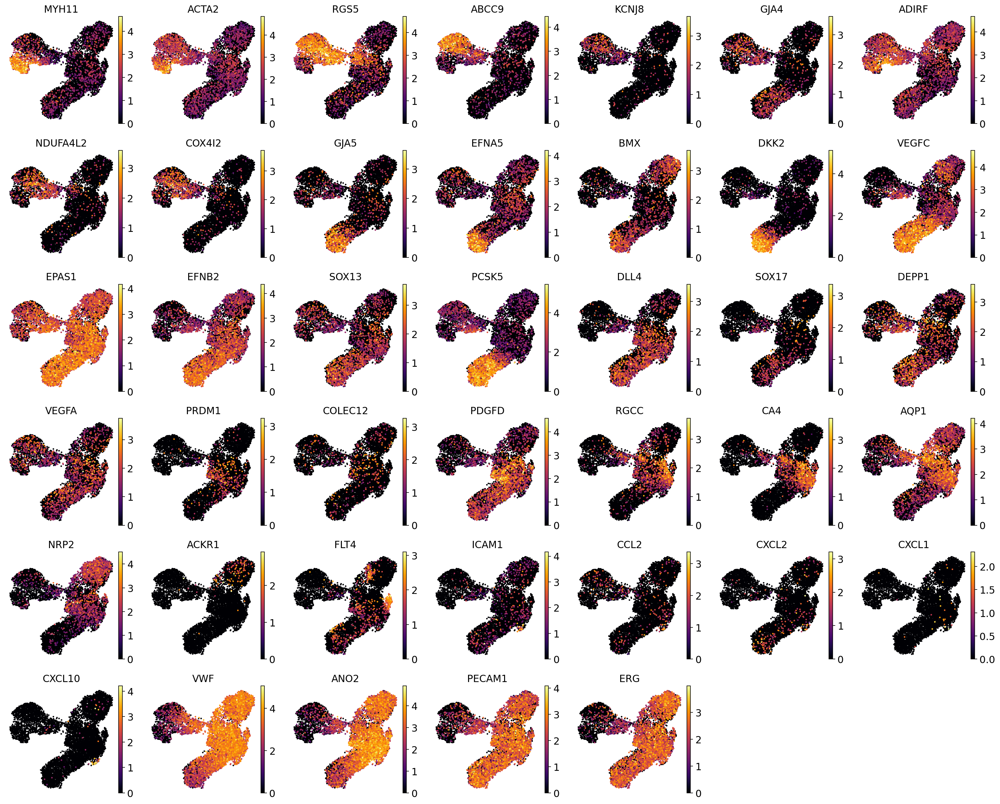

In [29]:
rcParams['figure.figsize'] = 3,3
rcParams['savefig.dpi'] = 300
sc.pl.umap(subadata, color = genes_plots_all, size = 20, frameon = False, 
                 color_map = "inferno", ncols = 7, wspace = 0.15)

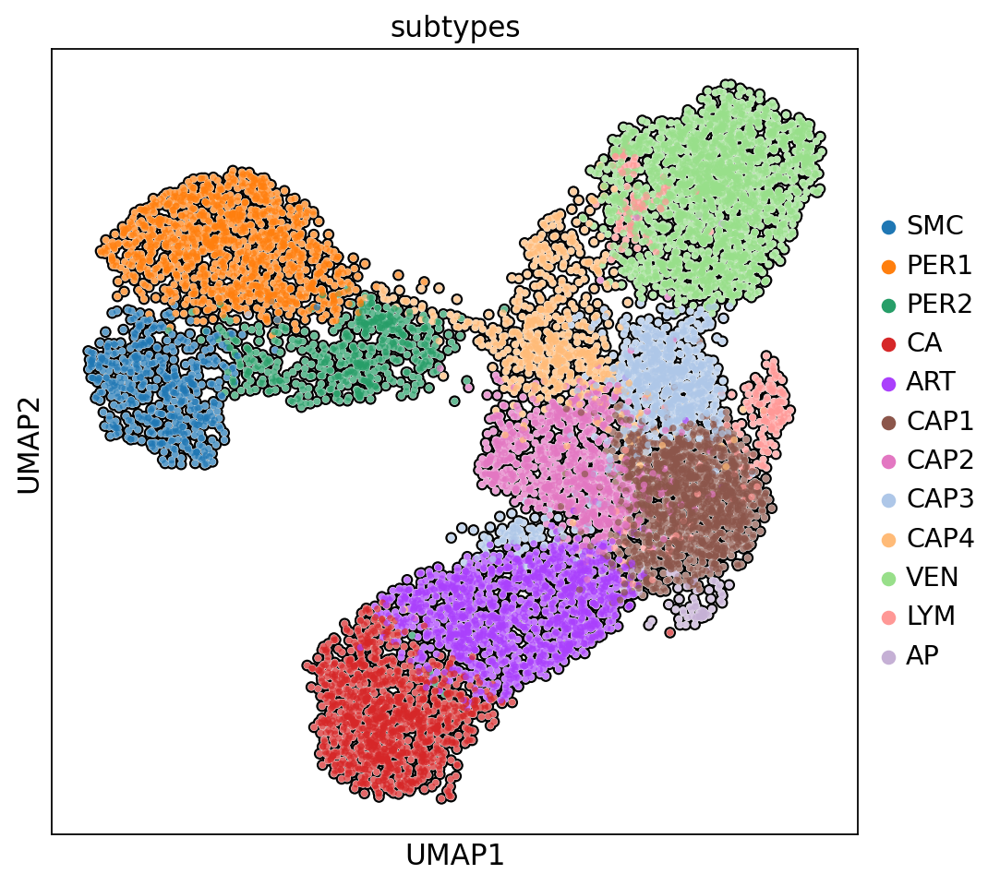

In [113]:
rcParams['figure.figsize'] = 7,7
sc.pl.umap(subadata, color = 'subtypes', size = 45,  add_outline=True, save = "umap.svg")

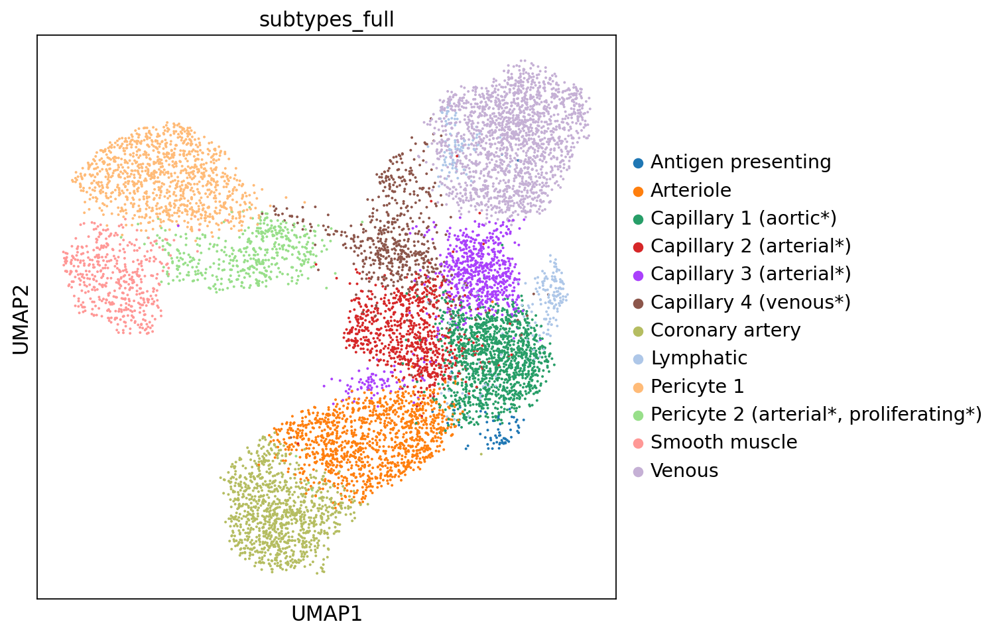

In [114]:
sc.pl.umap(subadata, color = ['subtypes_full'])

In [173]:
subadata.write_h5ad('../h5ad/subadata_EC2.h5ad')

In [17]:
#subadata = sc.read_h5ad('../h5ad/subadata_EC2.h5ad')

In [36]:
cell_types_order = subadata.obs.subtypes_full2.value_counts().index.to_list()

In [37]:
cell_types_order

['Venous',
 'Capillary 1',
 'Arteriole',
 'Pericyte 1',
 'Coronary artery',
 'Capillary 2',
 'Capillary 3',
 'Capillary 4',
 'Smooth muscle',
 'Pericyte 2',
 'Lymphatic',
 'Inflammatory']

In [60]:
def percentage(subadata):
    distrib = subadata.obs.subtypes_full2.value_counts()
    num_cells = subadata.obs.shape[0]
    perc = []
    for cell_type  in cell_types_order:
        if cell_type in list(set(subadata.obs.subtypes_full2)):
            perc.append(round((100 * distrib[cell_type] / num_cells), 2))
        else:
            perc.append(0)
    return(perc)

In [61]:
percentages = {}
for phenotype in set(subadata.obs.phenotype):
    percentages[phenotype] = percentage(subadata[subadata.obs.phenotype == phenotype])

In [62]:
cell_types = cell_types_order
df = pd.DataFrame(percentages, index = cell_types)

In [63]:
df

,HF_Congestive,CAD,HF_CAD,Control
Venous,19.71,11.56,22.50,17.38
Capillary 1,13.10,12.20,11.08,14.91
Arteriole,13.43,6.74,14.33,13.72
Pericyte 1,5.39,19.90,8.17,11.00
Coronary artery,12.16,6.10,13.54,10.91
Capillary 2,14.29,5.78,7.94,5.47
Capillary 3,8.86,9.84,6.97,6.17
Capillary 4,3.84,10.38,3.60,6.57
Smooth muscle,1.22,7.38,5.37,5.93
Pericyte 2,1.88,8.40,3.26,5.77


In [64]:
df.columns = ["Heart failure (Ischemic)", "Heart failure (no Ischemic)", "Control", "Ischemic"]

In [65]:
import matplotlib
myorder=[0,1,2,3,4,5,6,7,8,9,10,11]
myorder=[11,5,4,1,3,6,9,10,0,2,12,13]
colors_raw = list(rcParams["axes.prop_cycle"][0:14])
colors_raw = [colors_raw[i] for i in myorder]
colors_raw = list(colors_raw)
colors = []
for elt in colors_raw:
    colors.append(matplotlib.colors.to_rgba(elt['color']))

In [66]:
colors

[(0.596078431372549, 0.8745098039215686, 0.5411764705882353, 1.0),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354, 1.0),
 (0.6666666666666666, 0.25098039215686274, 0.9882352941176471, 1.0),
 (1.0, 0.4980392156862745, 0.054901960784313725, 1.0),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 1.0),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902, 1.0),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274, 1.0),
 (1.0, 0.7333333333333333, 0.47058823529411764, 1.0),
 (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 1.0),
 (0.15294117647058825, 0.6196078431372549, 0.40784313725490196, 1.0),
 (1.0, 0.596078431372549, 0.5882352941176471, 1.0),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589, 1.0)]

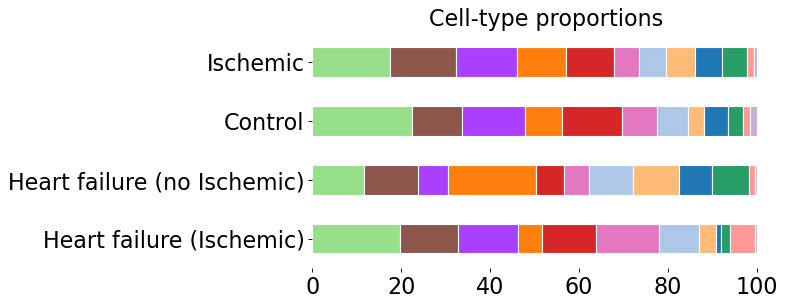

In [70]:
cell_types = cell_types_order
from matplotlib import pyplot as plt
font = {'size'   : 12}

matplotlib.rc('font', **font)

# Very simple one-liner using our agg_tips DataFrame.
rcParams['figure.figsize'] = 10,4
ax = df.T.plot(kind='barh', stacked=True, legend = False, grid = False, color = colors, edgecolor = "w")

# Just add a title and rotate the x-axis labels to be horizontal.
plt.title('Cell-type proportions', fontsize = 20)
plt.xticks(rotation=0, ha='center', fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
for pos in ['right', 'top', 'bottom', 'left']: 
    plt.gca().spines[pos].set_visible(False) 
handles,labels = ax.get_legend_handles_labels()
handles = [handles[0], handles[6], handles[1], handles[7], handles[2], handles[8], handles[3], handles[9],handles[4], handles[10],handles[5], handles[11]]
labels = [labels[0], labels[6], labels[1], labels[7], labels[2], labels[8], labels[3], labels[9],labels[4], labels[10],labels[5], labels[11]]
#plt.legend(handles,labels, loc='best', bbox_to_anchor=(1.1, 0, 0, 2), ncol = 6, fontsize = 20)


... storing 'samples' as categorical


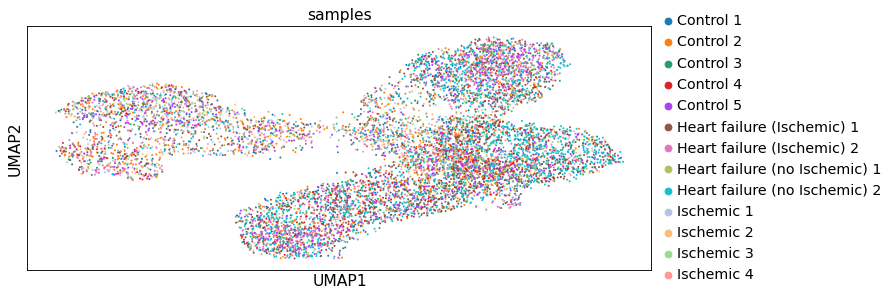

In [49]:
subadata.obs['samples'] = subadata.obs['sample_id'].astype(int).replace({1: 'Ischemic 1',16: 'Ischemic 2', 22: 'Ischemic 3', 174: "Heart failure (no Ischemic) 1", 281: "Heart failure (no Ischemic) 2",
                                                                        35: 'Control 1', 66: 'Control 2', 202: 'Control 3', 
                                                                        201: 'Ischemic 4', 234: 'Control 4', 170: 'Control 5', 58: 'Heart failure (Ischemic) 1', 91: "Heart failure (Ischemic) 2"})
sc.pl.umap(subadata, color = ['samples'])

order = ['Control 1', 'Control 2', 'Control 3', 'Control 4', 'Control 5', 'Ischemic 1', 'Ischemic 2', 'Ischemic 3', 'Ischemic 4', 'Heart failure (Ischemic) 1', 'Heart failure (Ischemic) 2', 'Heart failure (no Ischemic) 1', 'Heart failure (no Ischemic) 2']
order.reverse()

subadata.obs.samples = subadata.obs.samples.cat.reorder_categories(order)

In [50]:
order = ['Control 1', 'Control 2', 'Control 3', 'Control 4', 'Control 5', 'Ischemic 1', 'Ischemic 2', 'Ischemic 3', 'Ischemic 4', 'Heart failure (Ischemic) 1', 'Heart failure (Ischemic) 2', 'Heart failure (no Ischemic) 1', 'Heart failure (no Ischemic) 2']
order.reverse()

subadata.obs.samples = subadata.obs.samples.cat.reorder_categories(order)

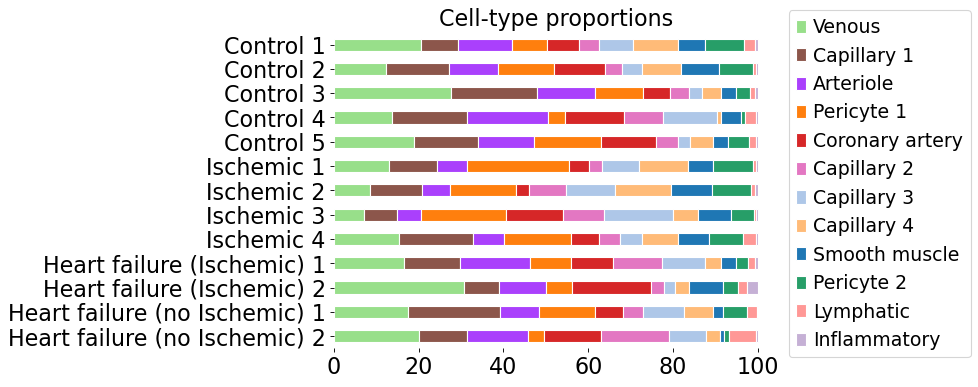

In [58]:
percentages = {}
for phenotype in subadata.obs.samples.cat.categories:
    percentages[phenotype] = percentage(subadata[subadata.obs.samples == phenotype])
#cell_types = ['VEN', 'CAP1', 'ART', 'PER1', 'CA', 'CAP2', 'CAP3', 'CAP4', 'SMC', 'PER2', 'LYM', 'IF']
df = pd.DataFrame(percentages, index = cell_types_order)
from matplotlib import pyplot as plt

# Very simple one-liner using our agg_tips DataFrame.
rcParams['figure.figsize'] = 10,5
df.T.plot(kind='barh', stacked=True, legend = False, grid = False, color = colors, edgecolor = "w")

# Just add a title and rotate the x-axis labels to be horizontal.
plt.title('Cell-type proportions', fontsize = 20)
plt.xticks(rotation=0, ha='center', fontsize = 20)
plt.yticks(fontsize = 20)
plt.tight_layout()
for pos in ['right', 'top', 'bottom', 'left']: 
    plt.gca().spines[pos].set_visible(False) 
#plt.legend(loc='best', bbox_to_anchor=(1.1, 0, 0, 2), ncol = 12, fontsize = 20)


plt.legend(loc='best', bbox_to_anchor=(1, 1.1
                                       , 0, 0), fontsize = 17)


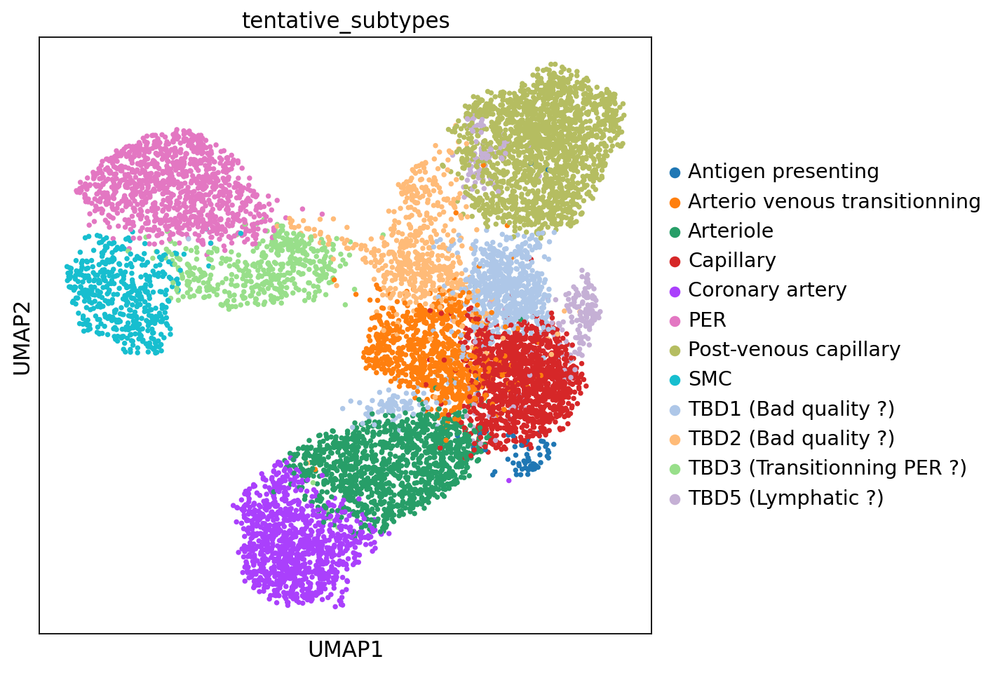

In [161]:
rcParams['figure.figsize'] = 7,7
sc.pl.umap(subadata, color = 'tentative_subtypes', size = 45)

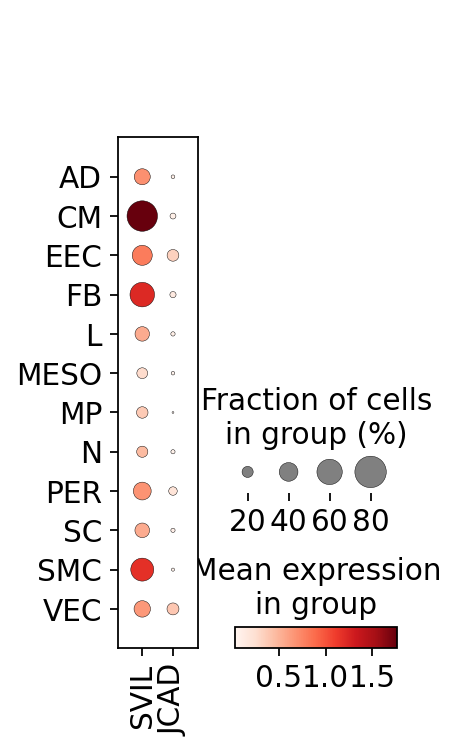

In [304]:
sc.pl.dotplot(adata, var_names = ["SVIL", "JCAD"], groupby = "cell_types")

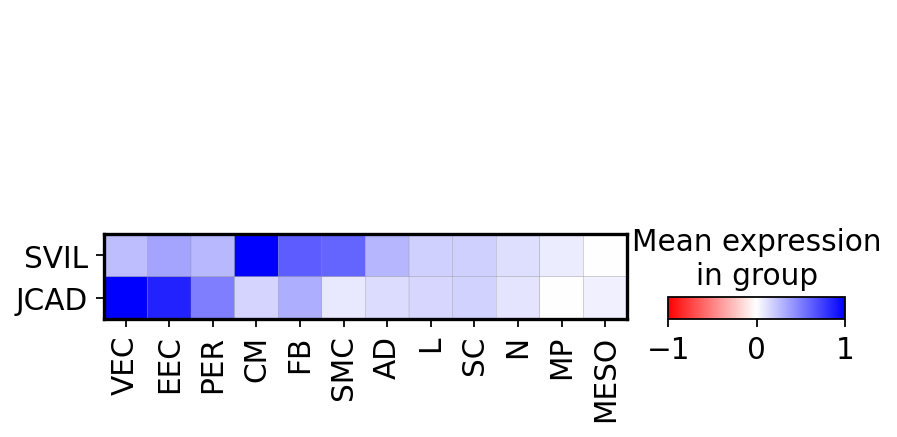

In [334]:
sc.pl.matrixplot(adata, var_names = ["SVIL", "JCAD"], groupby = "cell_types", standard_scale = "var", cmap = "bwr_r", swap_axes = True, vmin = -1, vmax = 1,
                categories_order = ["VEC", "EEC", "PER", "CM", "FB", "SMC", "AD", "L", "SC", "N", "MP", "MESO"])

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


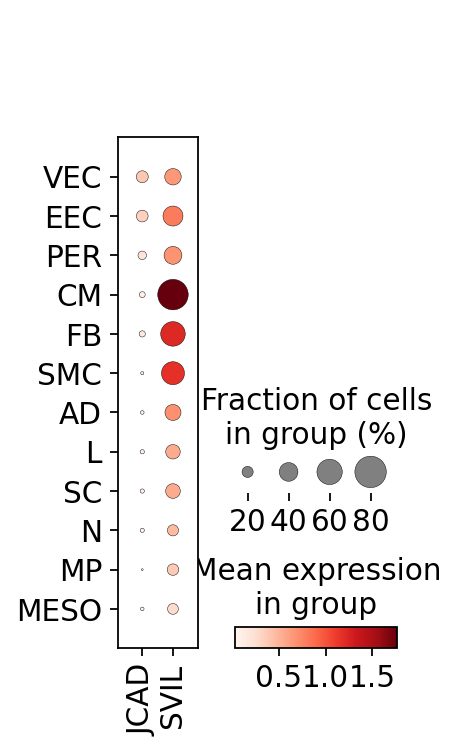

In [328]:
sc.pl.dotplot(adata, var_names = ["JCAD", "SVIL"], groupby = "cell_types", swap_axes = False,
                categories_order = ["VEC", "EEC", "PER", "CM", "FB", "SMC", "AD", "L", "SC", "N", "MP", "MESO"])

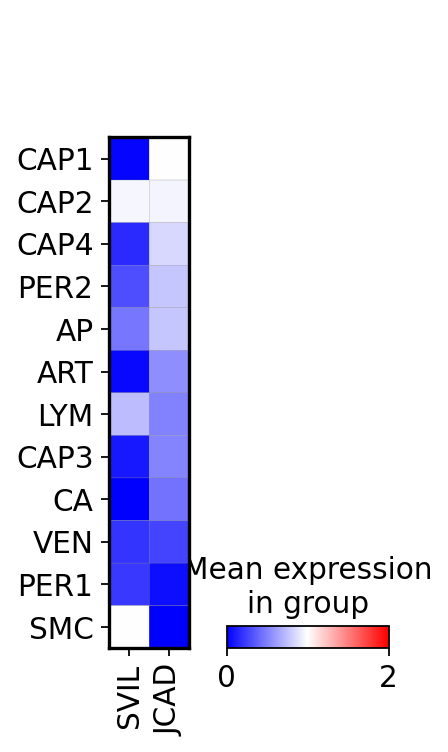

In [331]:
sc.pl.matrixplot(subadata, var_names = ["SVIL", "JCAD"], groupby = "subtypes", standard_scale = "var", cmap = "bwr",
                categories_order = ["CAP1", "CAP2", "CAP4", "PER2", "AP", "ART", "LYM", "CAP3", "CA", "VEN", "PER1", "SMC"], vmin = 0, vmax = 2)

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


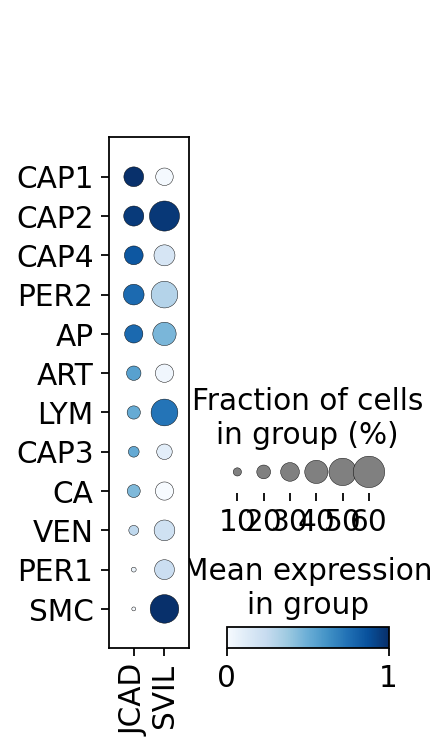

In [323]:
sc.pl.dotplot(subadata, var_names = ["JCAD", "SVIL"], groupby = "subtypes", cmap = "Blues", swap_axes = False, standard_scale = "var",
             categories_order = ["CAP1", "CAP2", "CAP4", "PER2", "AP", "ART", "LYM", "CAP3", "CA", "VEN", "PER1", "SMC"])

In [11]:
subadata = sc.read_h5ad('../h5ad/subadata_EC2.h5ad')

CA


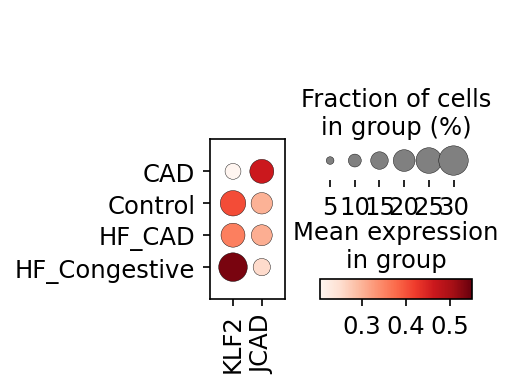

ART


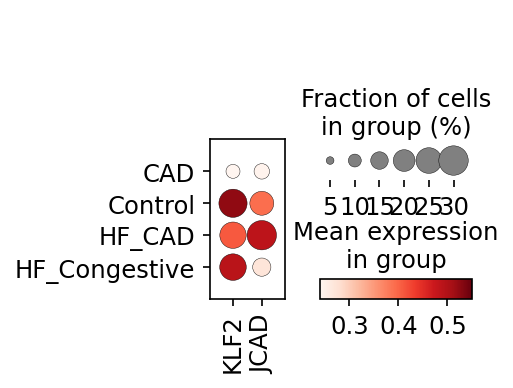

PER1


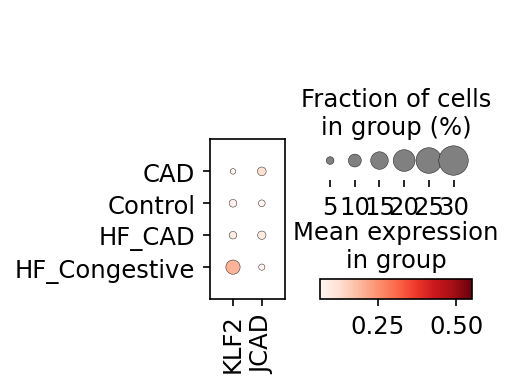

In [38]:
for subtype in ["CA", "ART", "PER1"]:
    print(subtype)
    subadata2 = subadata[subadata.obs.subtypes == subtype]
    sc.pl.dotplot(subadata2, groupby = 'phenotype', var_names = ["KLF2", "JCAD"], save = subtype + "_klf_jcad.svg", dot_max = 0.30, vmax = 0.55)